<a href="https://colab.research.google.com/github/kurtsenol/machine-learning/blob/master/TopicModeling/LDA_50_topics_final4.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Topic Modeling Implementation on Tourism Related Articles

In [ ]:
!python -m spacy download en_core_web_md

     |████████████████████████████████| 96.4MB 1.2MB/s 
  Created wheel for en-core-web-md: filename=en_core_web_md-2.2.5-cp36-none-any.whl size=98051305 sha256=315fa83d5668a3105f7cfede6a0e5f0d6a6c576c706ada9404a097ab64153978
  Stored in directory: /tmp/pip-ephem-wheel-cache-juofjqjy/wheels/df/94/ad/f5cf59224cea6b5686ac4fd1ad19c8a07bc026e13c36502d81
Successfully built en-core-web-md
✔ Download and installation successful
You can now load the model via spacy.load('en_core_web_md')


In [ ]:
import os
import numpy as np
import pandas as pd
import pickle

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Dataset

Below is our dataset:

In [ ]:
df = pd.read_pickle("drive/My Drive/Topic_Modeling/topic_df.pkl")

In [ ]:
df

,Title,Journal,Year,Abstract
0,TWO-DIRECTIONAL CONVERGENCE OF PLATFORM AND PI...,JOURNAL OF SERVICE MANAGEMENT,2020,PURPOSE THIS ARTICLE EXAMINES THE NEW PHENOMEN...
1,EMPLOYEE WELLNESS ON THE FRONTLINE: AN INTERAC...,JOURNAL OF SERVICE MANAGEMENT,2020,PURPOSE EMPLOYEE WELLNESS IS VITAL TO CREATING...
2,DEMOGRAPHIC AND ATTITUDINAL ANTECEDENTS OF CON...,JOURNAL OF SERVICE MANAGEMENT,2020,PURPOSE TO INVESTIGATE IF ONLINE TV CONTENT PL...
3,MORE THAN A FEELING? TOWARD A THEORY OF CUSTOM...,JOURNAL OF SERVICE MANAGEMENT,2020,PURPOSE RESPONDING TO AN INCREASING CALL FOR A...
4,ACCOUNTABLE ALGORITHMS? THE ETHICAL IMPLICATIO...,JOURNAL OF SERVICE MANAGEMENT,2020,PURPOSE THE PURPOSE OF THIS STUDY IS TO IDENTI...
...,...,...,...,...
11923,MEASURING SEASONAL DEMAND FOR SPANISH AIRPORTS...,RESEARCH IN TRANSPORTATION BUSINESS & MANAGEMENT,2011,"USING GINI COEFFICIENTS, THIS PAPER INVESTIGAT..."
11924,NEW EMPIRICAL EVIDENCE ON AIRPORT CAPACITY UTI...,RESEARCH IN TRANSPORTATION BUSINESS & MANAGEMENT,2011,AN IMPORTANT QUESTION IN FORECASTING AIR TRAFF...
11925,"POTENTIAL FOR ABU DHABI, DOHA AND DUBAI AIRPOR...",RESEARCH IN TRANSPORTATION BUSINESS & MANAGEMENT,2011,THE AIR TRANSPORT MARKET IN THE MIDDLE EAST IS...
11926,SEEDING GROWTH AT AIRPORTS AND AIRPORT CITIES:...,RESEARCH IN TRANSPORTATION BUSINESS & MANAGEMENT,2011,AIRPORTS ARE EVOLVING FROM SIMPLE INFRASTRUCTU...


In [ ]:
# df_csv=df.copy()
# df_csv.to_csv("Journal.txt")

In [ ]:
# download("/content/Journal.txt")

In [ ]:
# df_excel = df.copy()

In [ ]:
# df_excel = df_excel.sort_values(["Journal", "Year"])
# df_excel.to_excel("Journal.xlsx", sheet_name="Total", index=False)
# with pd.ExcelWriter('Journal.xlsx', mode="a") as writer:  
    
#     for j in df_excel.Journal.unique():
#       df_excel[df_excel.Journal==j].to_excel(writer, sheet_name=j, index=False)
    

In [ ]:
# download("/content/Journal.xlsx")

In [ ]:
# df.info()

The dataset includes **11928** articles from **19 journals**, including title, journal name, publication year and abstract information.

In [ ]:
# df.groupby('Journal')['Abstract'].count().sort_values()

The number of articles per journal is as above: 

In [ ]:
# order = df.Journal.value_counts(ascending=True).index

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.set()

In [ ]:
# plt.figure(figsize=(18,10))
# sns.countplot(y='Journal', data=df, orient='h', order=order);

You can find graph version the same info above:

In [ ]:
# plt.figure(figsize=(12,6))
# sns.countplot(x='Year', data=df, orient='v');

The number of yearly publications is above:

In [ ]:
# def color_zeros(val):
#   background_color = 'yellow' if val == 0 else 'white'
#   return 'background-color: %s' % background_color

In [ ]:
# df_o = pd.crosstab(df.Journal, df.Year, dropna=False)#.style.applymap(color_zeros)
# df_o

The number of articles per journal per year is above:

In [ ]:
# sns.set(font_scale=1.5)
# sns.catplot(data=df, x='Year', col="Journal", col_wrap=3, sharex=False, height=10, kind='count');


Subgraphs for the number of articles per year per journal are above:

## Analysis

In [ ]:
papers = list(df.Abstract.values)

In [ ]:
import nltk
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [ ]:
stop_words = nltk.corpus.stopwords.words('english')

In [ ]:
!pip install pyLDAvis

In [ ]:
import numpy as np
import pandas as pd
from pprint import pprint

# Gensim
import gensim
import gensim.corpora as corpora
from gensim.utils import simple_preprocess
from gensim.models import CoherenceModel

# spacy for lemmatization
import spacy

# Plotting tools
import pyLDAvis
import pyLDAvis.gensim  # don't skip this
import matplotlib.pyplot as plt

### Tokenize Sentences and Clean

In [ ]:
def sent_to_words(sentences):
    for sent in sentences:
        sent = gensim.utils.simple_preprocess(str(sent), deacc=True) 
        yield(sent)  

# Convert to list
data = papers
data_words = list(sent_to_words(data))

### Build the Bigram, Trigram Models and Lemmatize

In [ ]:
# Build the bigram and trigram models
bigram = gensim.models.Phrases(data_words, min_count=20, threshold=100) # higher threshold fewer phrases.
trigram = gensim.models.Phrases(bigram[data_words], threshold=100)  

bigram_mod = gensim.models.phrases.Phraser(bigram)
trigram_mod = gensim.models.phrases.Phraser(trigram)

nlp = spacy.load('en_core_web_md', disable=['parser', 'ner'])


# !python3 -m spacy download en  # run in terminal once
def process_words(texts, stop_words=stop_words, allowed_postags=['NOUN', 'ADJ', 'VERB', 'ADV']):
    """Remove Stopwords, Form Bigrams, Trigrams and Lemmatization"""
    texts = [[word for word in simple_preprocess(str(doc), deacc=True, min_len=3) if word not in stop_words] for doc in texts]
    texts = [bigram_mod[doc] for doc in texts]
    texts = [trigram_mod[bigram_mod[doc]] for doc in texts]
    texts_out = []
    
    for sent in texts:
        doc = nlp(" ".join(sent)) 
        texts_out.append([token.lemma_ for token in doc if token.pos_ in allowed_postags and len(token.text)>3])
    # remove stopwords once more after lemmatization
    texts_out = [[word for word in simple_preprocess(str(doc), deacc=True, min_len=3) if word not in stop_words] for doc in texts_out]    
    return texts_out

/usr/local/lib/python3.6/dist-packages/gensim/models/phrases.py:598: UserWarning: For a faster implementation, use the gensim.models.phrases.Phraser class
  warnings.warn("For a faster implementation, use the gensim.models.phrases.Phraser class")


In [ ]:
data_ready = process_words(data_words)  # processed Text Data!

Above we preprocess the corpus that includes: 
- removing stop words,
- doing lemmatization,
- implementing ngrams,
- selection of tokens based on speech of tags (*keep the words that are either noun, adjective, verb or adverb*)

### Create the Dictionary and Corpus needed for Topic Modeling

In [ ]:
# Create Dictionary
id2word = corpora.Dictionary(data_ready)

print('Total Vocabulary Size:', len(id2word))

Total Vocabulary Size: 15089


After preprocessing step we form a dictionary that the model requires.

In [ ]:
# Create Corpus: Term Document Frequency
corpus = [id2word.doc2bow(text) for text in data_ready]

In [ ]:
dict_corpus = {}

for i in range(len(corpus)):
  for idx, freq in corpus[i]:
    if id2word[idx] in dict_corpus:
      dict_corpus[id2word[idx]] += freq
    else:
       dict_corpus[id2word[idx]] = freq


In [ ]:
dict_df = pd.DataFrame.from_dict(dict_corpus, orient='index', columns=['freq'])

In [ ]:
# import seaborn as sns
# plt.figure(figsize=(12,8))
# sns.distplot(dict_df['freq'], bins=100);

Above is the graph for word frequencies of our dictionary, just to have general idea about the words and their frequencies. Most of the words have frequency values less than 1000. 

Below you can find the list of high frequency words in descending order. We will add those words that appear 3000 times or  more to stop list and restart the preprocess step to get better topic clusters. As expected, sector specific and general writing words have high frequencies.  

In [ ]:
dict_df[dict_df.freq>3000].sort_values('freq', ascending=False).head(60)

,freq
tourism,16670
study,16577
research,8515
tourist,8326
hotel,7370
use,7233
service,7044
result,7009
destination,6609
customer,6052


In [ ]:
extension = dict_df[dict_df.freq>3000].index.tolist()

In [ ]:
stop_words.extend(extension)

In [ ]:
data_ready = process_words(data_words)

In [ ]:
# Create Dictionary
id2word = corpora.Dictionary(data_ready)

print('Total Vocabulary Size:', len(id2word))

Total Vocabulary Size: 15230


 After removing the high frequency words there remains **15230** words in our dictionary.

In [ ]:
# # Create Corpus: Term Document Frequency
# corpus = [id2word.doc2bow(text) for text in data_ready]

In [ ]:
#ids = [id2word.token2id[extension[i]] for i in range(len(extension))]

In [ ]:
#id2word.filter_tokens(bad_ids=ids)

Next, we removed all terms that appear in less than 5 documents and all
terms that occur in more than 50% of all the documents. We are interested in finding different themes and topics and not recurring themes.

In [ ]:
# Filter out words that occur less than 20 documents, or more than 50% of the documents.

id2word.filter_extremes(no_below=5, no_above=0.5)

print('Total Vocabulary Size:', len(id2word))

Total Vocabulary Size: 5976


After final step there are **5976** words in the dictionary.


In [ ]:
# Create Corpus: Term Document Frequency
corpus = [id2word.doc2bow(text) for text in data_ready]

### Build the Topic Model

In [ ]:
# !wget http://mallet.cs.umass.edu/dist/mallet-2.0.8.zip

In [ ]:
# !unzip mallet-2.0.8.zip

In [ ]:
# mallet_path = '/content/mallet-2.0.8/bin/mallet'

In [ ]:
# iterations = [1000, 2000, 5000]
# alphas = [0.01, 0.2, 1, 50]

In [ ]:
# for alpha in alphas:
#   for i in iterations:
#     ldamallet = gensim.models.wrappers.LdaMallet( mallet_path, corpus=corpus, num_topics=10, id2word=id2word, iterations=2000, alpha=0.2, workers=16)

#     coherence_model_ldamallet = CoherenceModel(model=ldamallet, texts=data_ready, dictionary=id2word, coherence='c_v')
#     coherence_ldamallet = coherence_model_ldamallet.get_coherence()
#     print('\nCoherence Score: ', alpha, "\t", i, "\t", coherence_ldamallet)

In [ ]:
num_topics=50

In [ ]:
# while coherence_ldamallet<0.45:
#   ldamallet = gensim.models.wrappers.LdaMallet(mallet_path, corpus=corpus, num_topics=num_topics, id2word=id2word, iterations=2000, alpha=5/num_topics, workers=64)
#   coherence_model_ldamallet = CoherenceModel(model=ldamallet, texts=data_ready, dictionary=id2word, coherence='c_v')
#   coherence_ldamallet = coherence_model_ldamallet.get_coherence()
#   print(coherence_ldamallet)

In [ ]:
#ldamallet = gensim.models.wrappers.LdaMallet(mallet_path, corpus=corpus, num_topics=num_topics, id2word=id2word, iterations=2000, alpha=5/num_topics, workers=64)

Below you can find the 50 topics formed by the model. For each topic there are 10 terms and their relative weights next to it in descending order.

In [ ]:
# # Show Topics
# pprint(ldamallet.show_topics(formatted=False, num_topics=num_topics))

# Compute Coherence Score
# coherence_model_ldamallet = CoherenceModel(model=ldamallet, texts=data_ready, dictionary=id2word, coherence='c_v')
# coherence_ldamallet = coherence_model_ldamallet.get_coherence()
# print('\nCoherence Score: ', coherence_ldamallet)

In [ ]:
#pickle.dump(ldamallet, open("drive/My Drive/Topic_Modeling/lda_mallet_50_final.pkl", "wb"))

In [ ]:
ldamallet = pickle.load(open("drive/My Drive/Topic_Modeling/lda_mallet_50_final.pkl", "rb"))

In [ ]:
# tm_results = ldamallet[corpus]

In [ ]:
#corpus_topics = [sorted(topics, key=lambda record: -record[1])[0] for topics in tm_results]

In [ ]:
topics = [[(term, round(wt, 3)) for term, wt in ldamallet.show_topic(n, topn=10)] for n in range(0, ldamallet.num_topics)]

Below is the Topic-Term matrix shows 10 terms that forms each topic.   

In [ ]:
topics_df = pd.DataFrame([[term for term, wt in topic] for topic in topics], columns = ['Term'+str(i) for i in range(1, 11)],
                         index=['Topic '+str(t) for t in range(1, ldamallet.num_topics+1)]).T
topics_df

,Topic 1,Topic 2,Topic 3,Topic 4,Topic 5,Topic 6,Topic 7,Topic 8,Topic 9,Topic 10,Topic 11,Topic 12,Topic 13,Topic 14,Topic 15,Topic 16,Topic 17,Topic 18,Topic 19,Topic 20,Topic 21,Topic 22,Topic 23,Topic 24,Topic 25,Topic 26,Topic 27,Topic 28,Topic 29,Topic 30,Topic 31,Topic 32,Topic 33,Topic 34,Topic 35,Topic 36,Topic 37,Topic 38,Topic 39,Topic 40,Topic 41,Topic 42,Topic 43,Topic 44,Topic 45,Topic 46,Topic 47,Topic 48,Topic 49,Topic 50
Term1,event,market,place,creation,network,green,brand,business,intention,innovation,visitor,sustainable,resident,price,scale,message,method,port,choice,risk,loyalty,volunteer,medical,family,visitor,community,image,efficiency,visitor,community,quality,emotion,work,online,chinese,gender,policy,firm,organizational,demand,water,work,food,resident,economic,casino,management,hospitality,online,theory
Term2,festival,segment,explore,purpose,city,environmental,loyalty,country,attitude,firm,park,sustainability,benefit,pricing,wine,consumer,propose,airport,decision,crisis,failure,host,scale,activity,visit,stakeholder,intention,property,heritage,local,attribute,positive,behavior,review,cultural,hospitality,sustainable,restaurant,manager,country,environmental,organizational,restaurant,behaviour,growth,revenue,manager,journal,information,framework
Term3,visitor,marketing,practice,process,spatial,practice,consumer,region,behavior,knowledge,nature,issue,support,strategy,develop,restaurant,approach,transport,time,safety,recovery,souvenir,brand,motivation,film,local,quality,location,cultural,ecotourism,guest,emotional,role,medium,culture,woman,change,financial,culture,estimate,energy,support,consumer,attitude,country,weather,hospitality,article,website,approach
Term4,sport,product,identity,framework,urban,sustainability,trust,sector,theory,business,management,approach,community,high,motivation,communication,apply,passenger,vacation,disaster,program,project,dimension,constraint,motivation,rural,loyalty,chain,site,resident,room,negative,engagement,host,wine,work,sustainability,hospitality,commitment,expenditure,management,engagement,local,perception,economy,game,practice,review,consumer,process
Term5,host,cluster,article,context,attraction,sustainable,role,economic,significant,strategy,conservation,challenge,quality,market,dimension,advertising,measure,cost,trip,perception,behavior,community,quality,leisure,site,capital,perception,measure,attraction,rural,importance,consumer,stress,user,generation,career,economic,corporate,level,market,system,hospitality,menu,place,arrival,time,strategy,literature,technology,propose
Term6,attendee,segmentation,cultural,design,pattern,consumer,test,entrepreneur,test,market,site,literature,perception,room,religious,tip,indicator,cruise,information,security,casino,migrant,develop,group,tour,economic,visitor,variable,place,sustainable,perception,response,negative,information,difference,female,governance,risk,leadership,variable,consumption,commitment,dining,cultural,demand,increase,purpose,future,internet,literature
Term7,exhibition,strategy,process,originality,location,corporate,luxury,small,positive,orientation,activity,perspective,positive,competition,item,type,evaluate,airline,holiday,management,consumer,home,measure,type,museum,approach,visit,high,indigenous,participation,traveler,consumption,positive,platform,group,student,system,company,hospitality,price,measure,manager,authenticity,group,policy,change,develop,academic,user,theoretical
Term8,attend,visitor,space,approach,area,guest,intention,local,theoretical,resource,wildlife,business,theory,level,measurement,high,criterion,transportation,preference,health,complaint,motivation,personality,child,activity,collaboration,cognitive,size,city,heritage,dimension,restaurant,moderate,consumer,consumer,difference,future,franchise,team,international,cost,role,consumption,local,period,gaming,interview,field,purchase,context
Term9,exhibitor,group,discourse,create,space,behavior,positive,rural,role,management,area,article,life,revenue,meas

In [ ]:
pd.set_option('display.max_colwidth', -1)

topics_df = pd.DataFrame([', '.join([term for term, wt in topic]) for topic in topics], columns = ['Terms per Topic'],
                         index=['Topic'+str(t) for t in range(1, ldamallet.num_topics+1)] )

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: FutureWarning: Passing a negative integer is deprecated in version 1.0 and will not be supported in future version. Instead, use None to not limit the column width.
  """Entry point for launching an IPython kernel.


### WordClouds

In [ ]:
from wordcloud import WordCloud

In [ ]:
wc = WordCloud(background_color="white", colormap="Dark2",
               max_font_size=150, random_state=42)

In [ ]:
plt.rcParams['figure.figsize'] = [50, 50]

Below is the word clouds, one for each topic. The font sizes of words show their relative weights in the topic.

In [ ]:
# use this to upload files
def upload():
  from google.colab import files
  uploaded = files.upload() 
  for name, data in uploaded.items():
    with open(name, 'wb') as f:
      f.write(data)
      print ('saved file', name)

In [ ]:
upload()

Saving lda_50_final_labeled_ST.xlsx to lda_50_final_labeled_ST (2).xlsx
saved file lda_50_final_labeled_ST.xlsx


In [ ]:
labels= pd.read_excel("/content/lda_50_final_labeled_ST.xlsx")

In [ ]:
labels = labels[["Dominant Topic", "Labels"]].dropna()

In [ ]:
labels["Labels"] = labels.Labels.str.title()
labels= labels.reset_index(drop=True)
labels

,Dominant Topic,Labels
0,1,Event Tourism
1,2,Market Segmentation
2,3,Cultural Tourism
3,4,Value Creation
4,5,Urban Tourism
5,6,Sustainability
6,7,Brand Loyalty
7,8,Regional Entrepreneurship
8,9,Theory Of Planned Behavior
9,10,Business Strategy


In [ ]:
# labels.to_excel("Labels.xlsx")

In [ ]:
# download("/content/Labels.xlsx")

In [ ]:
params = {'axes.titlesize': 35}
          
plt.rcParams.update(params)

In [ ]:
# Create subplots for each comedian
i=0
for i in range(num_topics):

    wc.generate(text=topics_df["Terms per Topic"][i])
    
    plt.subplot(10, 5, i+1)
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.title("T"+str(i+1)+": "+labels.loc[i, "Labels"])

plt.tight_layout()
plt.show()

In [ ]:
import pyLDAvis.gensim as gensimvis
import pyLDAvis

In [ ]:
from gensim.models.ldamodel import LdaModel
def convertldaGenToldaMallet(mallet_model):
    model_gensim = LdaModel(
        id2word=mallet_model.id2word, num_topics=mallet_model.num_topics,
        alpha=mallet_model.alpha) # original function has 'eta=0' argument
    model_gensim.state.sstats[...] = mallet_model.wordtopics
    model_gensim.sync_state()
    return model_gensim

In [ ]:
new_lda = convertldaGenToldaMallet(ldamallet)

Below is an interactive graph shows the topics and relative terms. You can hover over bubbles and get the most relevant 30 words on the right.


In [ ]:
vis_data = gensimvis.prepare(new_lda, corpus, id2word, sort_topics=False)
pyLDAvis.display(vis_data)

In [ ]:
# corpus_topic_df = pd.DataFrame()

# corpus_topic_df['Document'] = range(0, len(corpus))

# corpus_topic_df['Dominant Topic'] = [item[0]+1 for item in corpus_topics]

# corpus_topic_df['Contribution %'] = [round(item[1]*100, 2) for item in corpus_topics]

# corpus_topic_df['Topic Desc'] = [topics_df.iloc[t[0]]['Terms per Topic'] for t in corpus_topics]

# corpus_topic_df['Title'] = df.Title

Below table shows the dominant topic, its weight and the title of each document. 

In [ ]:
# corpus_topic_df

In [ ]:
# corpus_topic_df.to_pickle("drive/My Drive/Topic_Modeling/corpus_topic_df.pkl")

In [ ]:
corpus_topic_df = pd.read_pickle("drive/My Drive/Topic_Modeling/corpus_topic_df.pkl")
corpus_topic_df

,Document,Dominant Topic,Contribution %,Topic Desc,Title
0,0,8,37.80,"business, country, region, sector, economic, entrepreneur, small, local, rural, regional",TWO-DIRECTIONAL CONVERGENCE OF PLATFORM AND PIPELINE BUSINESS MODELS
1,1,39,40.22,"organizational, manager, culture, commitment, level, leadership, hospitality, team, management, test",EMPLOYEE WELLNESS ON THE FRONTLINE: AN INTERACTIONAL PSYCHOLOGY PERSPECTIVE
2,2,34,32.34,"online, review, medium, host, user, information, platform, consumer, airbnb, share",DEMOGRAPHIC AND ATTITUDINAL ANTECEDENTS OF CONSUMERS' USE AND SELF-INVESTMENT TRAJECTORIES OVER TIME IN AN ONLINE TV CONTENT PLATFORM
3,3,4,62.56,"creation, purpose, process, framework, context, design, originality, approach, create, literature",MORE THAN A FEELING? TOWARD A THEORY OF CUSTOMER DELIGHT
4,4,4,41.94,"creation, purpose, process, framework, context, design, originality, approach, create, literature",ACCOUNTABLE ALGORITHMS? THE ETHICAL IMPLICATIONS OF DATA-DRIVEN BUSINESS MODELS
...,...,...,...,...,...
11923,11923,18,47.55,"port, airport, transport, passenger, cost, cruise, airline, transportation, public, system",MEASURING SEASONAL DEMAND FOR SPANISH AIRPORTS: IMPLICATIONS\nFOR COUNTER-SEASONAL STRATEGIES
11924,11924,18,49.70,"port, airport, transport, passenger, cost, cruise, airline, transportation, public, system",NEW EMPIRICAL EVIDENCE ON AIRPORT CAPACITY UTILISATION: RELATIONSHIPS BETWEEN HOURLY\nAND ANNUAL AIR TRAFFIC VOLUMES
11925,11925,18,76.28,"port, airport, transport, passenger, cost, cruise, airline, transportation, public, system","POTENTIAL FOR ABU DHABI, DOHA AND DUBAI AIRPORTS TO REACH THEIR TRAFFIC OBJECTIVES"
11926,11926,18,72.39,"port, airport, transport, passenger, cost, cruise, airline, transportation, public, system",SEEDING GROWTH AT AIRPORTS AND AIRPORT CITIES: INSIGHTS FROM THE TWO-SIDED\nMARKET LITERATURE


In [ ]:
corpus_topic_df_lables = pd.merge(corpus_topic_df, labels, left_on="Dominant Topic", right_on="Dominant Topic", left_index=True).sort_values('Document').reset_index(drop=True)
corpus_topic_df_lables = corpus_topic_df_lables[["Document",	"Dominant Topic",	"Labels", "Contribution %",	"Topic Desc",	"Title"]]
corpus_topic_df_lables

,Document,Dominant Topic,Labels,Contribution %,Topic Desc,Title
0,0,8,Regional Entrepreneurship,37.80,"business, country, region, sector, economic, entrepreneur, small, local, rural, regional",TWO-DIRECTIONAL CONVERGENCE OF PLATFORM AND PIPELINE BUSINESS MODELS
1,1,39,Organizational Culture,40.22,"organizational, manager, culture, commitment, level, leadership, hospitality, team, management, test",EMPLOYEE WELLNESS ON THE FRONTLINE: AN INTERACTIONAL PSYCHOLOGY PERSPECTIVE
2,2,34,Online Reviews,32.34,"online, review, medium, host, user, information, platform, consumer, airbnb, share",DEMOGRAPHIC AND ATTITUDINAL ANTECEDENTS OF CONSUMERS' USE AND SELF-INVESTMENT TRAJECTORIES OVER TIME IN AN ONLINE TV CONTENT PLATFORM
3,3,4,Value Creation,62.56,"creation, purpose, process, framework, context, design, originality, approach, create, literature",MORE THAN A FEELING? TOWARD A THEORY OF CUSTOMER DELIGHT
4,4,4,Value Creation,41.94,"creation, purpose, process, framework, context, design, originality, approach, create, literature",ACCOUNTABLE ALGORITHMS? THE ETHICAL IMPLICATIONS OF DATA-DRIVEN BUSINESS MODELS
...,...,...,...,...,...,...
11923,11923,18,Transportation,47.55,"port, airport, transport, passenger, cost, cruise, airline, transportation, public, system",MEASURING SEASONAL DEMAND FOR SPANISH AIRPORTS: IMPLICATIONS\nFOR COUNTER-SEASONAL STRATEGIES
11924,11924,18,Transportation,49.70,"port, airport, transport, passenger, cost, cruise, airline, transportation, public, system",NEW EMPIRICAL EVIDENCE ON AIRPORT CAPACITY UTILISATION: RELATIONSHIPS BETWEEN HOURLY\nAND ANNUAL AIR TRAFFIC VOLUMES
11925,11925,18,Transportation,76.28,"port, airport, transport, passenger, cost, cruise, airline, transportation, public, system","POTENTIAL FOR ABU DHABI, DOHA AND DUBAI AIRPORTS TO REACH THEIR TRAFFIC OBJECTIVES"
11926,11926,18,Transportation,72.39,"port, airport, transport, passenger, cost, cruise, airline, transportation, public, system",SEEDING GROWTH AT AIRPORTS AND AIRPORT CITIES: INSIGHTS FROM THE TWO-SIDED\nMARKET LITERATURE


### Dominant Topics Distribution Across Corpus

The first thing we can do is look at the overall distribution of each topic across the corpus of research papers.

In [ ]:
pd.set_option('display.max_colwidth', 200)

In [ ]:
topic_stats_df = corpus_topic_df.groupby('Dominant Topic').agg(
                                  Doc_Count = ('Dominant Topic', np.size),
                                  Total_Docs_Perc = ('Dominant Topic', np.size)).reset_index()

# topic_stats_df = topic_stats_df['Dominant Topic'].reset_index()

topic_stats_df['Total_Docs_Perc'] = topic_stats_df['Total_Docs_Perc'].apply(lambda row: round((row*100) / len(corpus_topic_df), 2))
topic_stats_df['Topic Desc'] = [topics_df.iloc[t]['Terms per Topic'] for t in range(len(topic_stats_df))]

topic_stats_df.sort_values("Total_Docs_Perc", ascending=False)

,Dominant Topic,Doc_Count,Total_Docs_Perc,Topic Desc
2,3,787,6.60,"place, explore, practice, identity, article, cultural, process, space, discourse, understand"
11,12,441,3.70,"sustainable, sustainability, issue, approach, challenge, literature, perspective, business, article, present"
36,37,412,3.45,"policy, sustainable, change, sustainability, economic, governance, system, future, develop, approach"
16,17,389,3.26,"method, propose, approach, apply, measure, indicator, evaluate, criterion, technique, improve"
3,4,372,3.12,"creation, purpose, process, framework, context, design, originality, approach, create, literature"
8,9,368,3.09,"intention, attitude, behavior, theory, significant, test, positive, theoretical, role, propose"
33,34,360,3.02,"online, review, medium, host, user, information, platform, consumer, airbnb, share"
39,40,342,2.87,"demand, country, estimate, expenditure, market, variable, price, international, distance, income"
44,45,338,2.83,"economic, growth, country, economy, arrival, demand, policy, period, increase, international"
6,7,337,2.83,"brand, loyalty, consumer, trust, role, test, luxury, intention, positive, behavior"


In [ ]:
topic_stats_df_lables = pd.merge(topic_stats_df, labels, left_on="Dominant Topic", right_on="Dominant Topic", left_index=True).sort_values("Total_Docs_Perc", ascending=False).reset_index(drop=True)
topic_stats_df_lables = topic_stats_df_lables[["Dominant Topic",	"Labels", "Doc_Count",	"Total_Docs_Perc",	"Topic Desc"]]
# topic_stats_df_lables.columns = ["Dominant Topic",	"Labels", "Document Count",	"Proportion (%)",	"Topic Terms"]
topic_stats_df_lables

,Dominant Topic,Labels,Doc_Count,Total_Docs_Perc,Topic Desc
0,3,Cultural Tourism,787,6.60,"place, explore, practice, identity, article, cultural, process, space, discourse, understand"
1,12,Sustainability Practices,441,3.70,"sustainable, sustainability, issue, approach, challenge, literature, perspective, business, article, present"
2,37,Sustainability In Tourism Policy,412,3.45,"policy, sustainable, change, sustainability, economic, governance, system, future, develop, approach"
3,17,Forecasting Methods,389,3.26,"method, propose, approach, apply, measure, indicator, evaluate, criterion, technique, improve"
4,4,Value Creation,372,3.12,"creation, purpose, process, framework, context, design, originality, approach, create, literature"
5,9,Theory Of Planned Behavior,368,3.09,"intention, attitude, behavior, theory, significant, test, positive, theoretical, role, propose"
6,34,Online Reviews,360,3.02,"online, review, medium, host, user, information, platform, consumer, airbnb, share"
7,40,Tourism Demand,342,2.87,"demand, country, estimate, expenditure, market, variable, price, international, distance, income"
8,45,Economic Growth,338,2.83,"economic, growth, country, economy, arrival, demand, policy, period, increase, international"
9,7,Brand Loyalty,337,2.83,"brand, loyalty, consumer, trust, role, test, luxury, intention, positive, behavior"


In [ ]:
# use this to download a file  
def download(path):
  from google.colab import files
  files.download(path)

In [ ]:
# topic_stats_df_lables.to_excel("Doc_counts.xlsx")

In [ ]:
# download("/content/Doc_counts.xlsx")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
topic_counts = topic_stats_df[["Dominant Topic", 	"Doc_Count", "Total_Docs_Perc"]]
topic_counts.columns  = ["Dominant Topic", 	"Document Count", "Total Document Percentage"]
topic_counts

,Dominant Topic,Document Count,Total Document Percentage
0,1,106,0.89
1,2,249,2.09
2,3,787,6.60
3,4,372,3.12
4,5,105,0.88
5,6,111,0.93
6,7,337,2.83
7,8,233,1.95
8,9,368,3.09
9,10,314,2.63


### Relevant Research Papers per Topic Based on Dominance



In [ ]:
df_dom = corpus_topic_df.groupby('Dominant Topic').apply(lambda topic_set: (topic_set.sort_values(by=['Contribution %'], ascending=False).iloc[:10])).reset_index(drop=True)

In [ ]:
df_dom

,Document,Dominant Topic,Contribution %,Topic Desc,Title
0,7412,1,73.65,"event, festival, visitor, sport, host, attendee, exhibition, attend, exhibitor, meeting",DOES SPORT EVENT SATISFACTION REMAIN STABLE OVER TIME?
1,9264,1,69.30,"event, festival, visitor, sport, host, attendee, exhibition, attend, exhibitor, meeting",SPORT TOURISTS' NOSTALGIA AND ITS EFFECT ON ATTITUDE AND INTENTIONS: A MULTILEVEL APPROACH
2,5813,1,67.26,"event, festival, visitor, sport, host, attendee, exhibition, attend, exhibitor, meeting",THE IMPACT OF A MEGA EVENT ON VISITORS' ATTITUDE TOWARD HOSTING DESTINATION: USING TRUST TRANSFER THEORY
3,476,1,66.24,"event, festival, visitor, sport, host, attendee, exhibition, attend, exhibitor, meeting",'ALL THAT JAZZ': THE RELATIONSHIP BETWEEN MUSIC FESTIVAL VISITORS' MOTIVES AND BEHAVIOURAL INTENTIONS
4,7047,1,65.73,"event, festival, visitor, sport, host, attendee, exhibition, attend, exhibitor, meeting",UNDERSTANDING CONVENTION ATTENDEE BEHAVIOR FROM THE PERSPECTIVE OF SELF-CONGRUITY: THE CASE OF ACADEMIC ASSOCIATION CONVENTION
...,...,...,...,...,...
495,11746,50,80.20,"theory, framework, approach, process, propose, literature, theoretical, context, develop, concept",BUILDING THEORIES FOR HOSPITALITY DISCIPLINE: AN ATTEMPT TO DESCRIBE AND ELABORATE REQUIRED PROCESSES AND PROCEDURES
496,11751,50,78.36,"theory, framework, approach, process, propose, literature, theoretical, context, develop, concept",A DUALISTIC MODEL OF TOURISM SEASONALITY: APPROACH–AVOIDANCE AND REGULATORY FOCUS THEORIES
497,898,50,77.01,"theory, framework, approach, process, propose, literature, theoretical, context, develop, concept",ADVANCING TOURISM RESEARCH THROUGH MULTILEVEL METHODS: RESEARCH PROBLEM AND AGENDA
498,5573,50,70.45,"theory, framework, approach, process, propose, literature, theoretical, context, develop, concept",A FRAMEWORK OF MEMORY MANAGEMENT AND TOURISM EXPERIENCES


In [ ]:
df_dom['Abstract'] = df_dom.Document.apply(lambda x: df.loc[x]['Abstract'])

In [ ]:
df_dom

,Document,Dominant Topic,Contribution %,Topic Desc,Title,Abstract
0,7412,1,73.65,"event, festival, visitor, sport, host, attendee, exhibition, attend, exhibitor, meeting",DOES SPORT EVENT SATISFACTION REMAIN STABLE OVER TIME?,"VERY LITTLE SCHOLARLY RESEARCH ANALYZES SPORTS EVENT VISITORS' SATISFACTION USING LONGITUDINAL STUDY DESIGNS. THUS, THIS STUDY INVESTIGATES WHETHER OR NOT SATISFACTION WITH EVENT SERVICES AND PROD..."
1,9264,1,69.30,"event, festival, visitor, sport, host, attendee, exhibition, attend, exhibitor, meeting",SPORT TOURISTS' NOSTALGIA AND ITS EFFECT ON ATTITUDE AND INTENTIONS: A MULTILEVEL APPROACH,"GIVEN THAT SPORT TOURISTS USUALLY COME TO SPORTING EVENTS IN GROUPS AND ARE EXPOSED TO MULTIPLE TYPES OF STIMULI, THE INFLUENCE OF SPORT TOURISTS' NOSTALGIA ON THEIR ATTITUDE OR BEHAVIOR CAN BE MO..."
2,5813,1,67.26,"event, festival, visitor, sport, host, attendee, exhibition, attend, exhibitor, meeting",THE IMPACT OF A MEGA EVENT ON VISITORS' ATTITUDE TOWARD HOSTING DESTINATION: USING TRUST TRANSFER THEORY,"DESPITE THE POPULARITY OF FESTIVALS AND EVENTS, EVENT MANAGERS AND THE HOSTING COUNTRIES ARE NOT CERTAIN WHETHER A SUCCESSFUL EVENT LEADS TO FAVORABLE ATTITUDES TOWARD THE HOSTING COUNTRY. THIS ST..."
3,476,1,66.24,"event, festival, visitor, sport, host, attendee, exhibition, attend, exhibitor, meeting",'ALL THAT JAZZ': THE RELATIONSHIP BETWEEN MUSIC FESTIVAL VISITORS' MOTIVES AND BEHAVIOURAL INTENTIONS,THIS EXPLORATORY STUDY INVESTIGATED THE RELATIONSHIP BETWEEN VISITORS' BEHAVIOURAL INTENTIONS (EX-POST) AND THEIR MOTIVES (EX-ANTE) FOR ATTENDING A JAZZ FESTIVAL. THE AIM WAS TO DISCOVER WHETHER A...
4,7047,1,65.73,"event, festival, visitor, sport, host, attendee, exhibition, attend, exhibitor, meeting",UNDERSTANDING CONVENTION ATTENDEE BEHAVIOR FROM THE PERSPECTIVE OF SELF-CONGRUITY: THE CASE OF ACADEMIC ASSOCIATION CONVENTION,"BASED ON THE CONCEPTS OF CONVENTION QUALITY, MULTIDIMENSIONAL VALUE, AND BEHAVIORAL INTENTIONS, THE CURRENT STUDY EXAMINES HOW DISTINCTIVELY CONVENTION ATTENDEES EVALUATE A CONVENTION WHEN THEY PE..."
...,...,...,...,...,...,...
495,11746,50,80.20,"theory, framework, approach, process, propose, literature, theoretical, context, develop, concept",BUILDING THEORIES FOR HOSPITALITY DISCIPLINE: AN ATTEMPT TO DESCRIBE AND ELABORATE REQUIRED PROCESSES AND PROCEDURES,"CONSIDERING THE NEED, THE PRIMARY INTENT OF THIS STUDY IS TO SPUR CONTEMPLATION RELATED TO BUILDING THEORIES THAT SPECIFICALLY PERTAIN TO THE HOSPITALITY DISCIPLINE. A REVIEW OF PROCESS REQUIRED F..."
496,11751,50,78.36,"theory, framework, approach, process, propose, literature, theoretical, context, develop, concept",A DUALISTIC MODEL OF TOURISM SEASONALITY: APPROACH–AVOIDANCE AND REGULATORY FOCUS THEORIES,"SEASONALITY IN TOURISM IS A KEY BUT POORLY UNDERSTOOD ISSUE IN THE CONTEXT OF THE TOURISM INDUSTRY. FURTHERMORE, THEORETICAL AND CONCEPTUAL DEVELOPMENTS REGARDING SEASONALITY IN TOURISM REMAIN LIM..."
497,898,50,77.01,"theory, framework, approach, process, propose, literature, theoretical, context, develop, concept",ADVANCING TOURISM RESEARCH THROUGH MULTILEVEL METHODS: RESEARCH PROBLEM AND AGENDA,"TOURISM RESEARCH OFTEN ENCOUNTERS SOCIAL PHENOMENA AND RESEARCH PROBLEMS THAT INVOLVE MULTIPLE LEVELS. HOWEVER, MOST RESEARCHERS ASSUME THAT THE PHENOMENA EXIST IN A SINGLE LEVEL AND PERFORM ANALY..."
498,5573,50,70.45,"theory, framework, approach, process, propose, literature, theoretical, context, develop, concept",A FRAMEWORK OF MEMORY MANAGEMENT AND TOURISM EXPERIENCES,THIS RESEARCH FIRST DEVELOPS A CONCEPTUAL MODEL TO LINK RELEVANT CONCEPTS IN PSYCHOLOGY AND TOURISM RESEARCH TO EACH STAGE OF THE LONG-TERM MEMORY (LTM) SYSTEM. IT COMBINES INSIGHTS FROM MINDFULNE...


In [ ]:
# df_dom.to_excel('/content/drive/My Drive/Colab Notebooks/TopicModeling/Options/lda_'+ str(num_topics) + ".xlsx")

In [ ]:
# tm_results = ldamallet[corpus]

Below is the table that shows topic weights for each  document.  

In [ ]:
# df_e = pd.DataFrame.from_records([{v: k for v, k in row} for row in tm_results])
# df_e.columns = ['Topic ' + str(i) for i in range(1,num_topics+1)]
# df_e

In [ ]:
# df_e.to_pickle("drive/My Drive/Topic_Modeling/df_e.pkl")

In [ ]:
df_e = pd.read_pickle("drive/My Drive/Topic_Modeling/df_e.pkl")
df_e

,Topic 1,Topic 2,Topic 3,Topic 4,Topic 5,Topic 6,Topic 7,Topic 8,Topic 9,Topic 10,Topic 11,Topic 12,Topic 13,Topic 14,Topic 15,Topic 16,Topic 17,Topic 18,Topic 19,Topic 20,Topic 21,Topic 22,Topic 23,Topic 24,Topic 25,Topic 26,Topic 27,Topic 28,Topic 29,Topic 30,Topic 31,Topic 32,Topic 33,Topic 34,Topic 35,Topic 36,Topic 37,Topic 38,Topic 39,Topic 40,Topic 41,Topic 42,Topic 43,Topic 44,Topic 45,Topic 46,Topic 47,Topic 48,Topic 49,Topic 50
0,0.000015,0.000015,0.000015,0.172911,0.000015,0.000015,0.000015,0.378013,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.262749,0.000015,0.000015,0.000015,0.185624,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015
1,0.000024,0.000024,0.000024,0.309463,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.268988,0.000024,0.000024,0.011774,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.003940,0.000024,0.000024,0.002635,0.402165,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024
2,0.000019,0.000019,0.000019,0.000019,0.000019,0.000019,0.289271,0.000019,0.000019,0.000019,0.000019,0.000019,0.000019,0.000019,0.000019,0.000019,0.092879,0.004289,0.000019,0.000019,0.000019,0.000019,0.000019,0.000019,0.000019,0.000019,0.000019,0.000019,0.000019,0.000019,0.000019,0.000019,0.006423,0.323426,0.000019,0.101417,0.000019,0.152650,0.001087,0.000019,0.000019,0.000019,0.000019,0.000019,0.000019,0.000019,0.000019,0.000019,0.027770,0.000019
3,0.000014,0.000014,0.161090,0.625552,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.212697,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014
4,0.000023,0.000023,0.000023,0.419432,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.247797,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.001314,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.077453,0.000023,0.000023,0.000023,0.252959
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11923,0.000044,0.170037,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.475531,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.012363,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.340030,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044
11924,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.153177,0.496981,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.348520,0.000028,0.000028,0.000028,0.000028
11925,0.000035,0.000035,0.003927,0.000035,0.000035,0.000035,0.000035,0.204355,0.001981,0.000035,0.000035,0.000035,0.000035,0.001981,0.013656,0.000035,0.001981,0.762829,0.000035,0.000

In [ ]:
df_e['Year'] = df.Year; df_e['Journal'] = df.Journal

Below table shows the topic distribuiton on a yearly basis. It is calculated by getting the mean of topic weights of all the documents published in a given year. Since the values are so close to each other it is difficult to get trends from this table.

In [ ]:
df_hot= df_e.groupby('Year').mean().T
df_hot

Year,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020
Topic 1,0.007058,0.013120,0.011283,0.014431,0.008506,0.011834,0.012199,0.011205,0.010655,0.008611
Topic 2,0.027310,0.025034,0.026268,0.029925,0.024195,0.024902,0.018718,0.017129,0.017134,0.009585
Topic 3,0.054941,0.067977,0.061280,0.049745,0.050467,0.060070,0.066569,0.061585,0.049975,0.056686
Topic 4,0.020683,0.019696,0.020432,0.027473,0.025651,0.024882,0.030662,0.039452,0.038437,0.038228
Topic 5,0.009030,0.009930,0.010675,0.010024,0.011434,0.011809,0.012591,0.013561,0.012582,0.016935
Topic 6,0.007405,0.008662,0.008857,0.017445,0.009366,0.010342,0.010717,0.009916,0.011487,0.011335
Topic 7,0.019447,0.014730,0.020725,0.021234,0.026903,0.021996,0.020723,0.026914,0.034640,0.030192
Topic 8,0.025963,0.023609,0.023681,0.023027,0.025137,0.023476,0.020482,0.016134,0.015989,0.014581
Topic 9,0.018966,0.027145,0.017639,0.023607,0.025774,0.028502,0.028497,0.031211,0.032972,0.037785
Topic 10,0.021995,0.021768,0.025312,0.023629,0.030256,0.025901,0.020977,0.027938,0.020685,0.020163


In [ ]:
df_hot["slope"] = df_hot.apply(lambda row: np.polyfit(range(2011,2021), row, deg=1)[0], axis=1)
df_hot

Year,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020,slope
Topic 1,0.007058,0.013120,0.011283,0.014431,0.008506,0.011834,0.012199,0.011205,0.010655,0.008611,-0.000043
Topic 2,0.027310,0.025034,0.026268,0.029925,0.024195,0.024902,0.018718,0.017129,0.017134,0.009585,-0.001778
Topic 3,0.054941,0.067977,0.061280,0.049745,0.050467,0.060070,0.066569,0.061585,0.049975,0.056686,-0.000295
Topic 4,0.020683,0.019696,0.020432,0.027473,0.025651,0.024882,0.030662,0.039452,0.038437,0.038228,0.002382
Topic 5,0.009030,0.009930,0.010675,0.010024,0.011434,0.011809,0.012591,0.013561,0.012582,0.016935,0.000680
Topic 6,0.007405,0.008662,0.008857,0.017445,0.009366,0.010342,0.010717,0.009916,0.011487,0.011335,0.000250
Topic 7,0.019447,0.014730,0.020725,0.021234,0.026903,0.021996,0.020723,0.026914,0.034640,0.030192,0.001579
Topic 8,0.025963,0.023609,0.023681,0.023027,0.025137,0.023476,0.020482,0.016134,0.015989,0.014581,-0.001229
Topic 9,0.018966,0.027145,0.017639,0.023607,0.025774,0.028502,0.028497,0.031211,0.032972,0.037785,0.001790
Topic 10,0.021995,0.021768,0.025312,0.023629,0.030256,0.025901,0.020977,0.027938,0.020685,0.020163,-0.000141


In [ ]:
df_hot = df_hot.sort_values("slope", ascending=False)
df_hot

Year,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020,slope
Topic 34,0.013729,0.017213,0.016514,0.017106,0.026770,0.024099,0.026920,0.032567,0.043194,0.044537,0.003431
Topic 45,0.018390,0.017398,0.018646,0.019733,0.028200,0.025459,0.032062,0.027813,0.033770,0.040746,0.002399
Topic 4,0.020683,0.019696,0.020432,0.027473,0.025651,0.024882,0.030662,0.039452,0.038437,0.038228,0.002382
Topic 9,0.018966,0.027145,0.017639,0.023607,0.025774,0.028502,0.028497,0.031211,0.032972,0.037785,0.001790
Topic 33,0.012998,0.018733,0.018196,0.023856,0.013661,0.020917,0.018521,0.027659,0.034443,0.027654,0.001700
Topic 7,0.019447,0.014730,0.020725,0.021234,0.026903,0.021996,0.020723,0.026914,0.034640,0.030192,0.001579
Topic 16,0.011423,0.013882,0.012900,0.018371,0.014746,0.017365,0.020755,0.016668,0.017092,0.020698,0.000816
Topic 32,0.014035,0.011567,0.017392,0.015134,0.012314,0.017330,0.015959,0.016070,0.019369,0.020345,0.000681
Topic 5,0.009030,0.009930,0.010675,0.010024,0.011434,0.011809,0.012591,0.013561,0.012582,0.016935,0.000680
Topic 15,0.010489,0.012888,0.011115,0.011264,0.015718,0.013479,0.012512,0.010621,0.015006,0.017087,0.000444


In [ ]:
params = {'axes.labelsize': 10,
          'axes.titlesize': 20,
          'xtick.labelsize': 15,
          'ytick.labelsize': 15,
          'legend.fontsize': 15}
          
plt.rcParams.update(params)

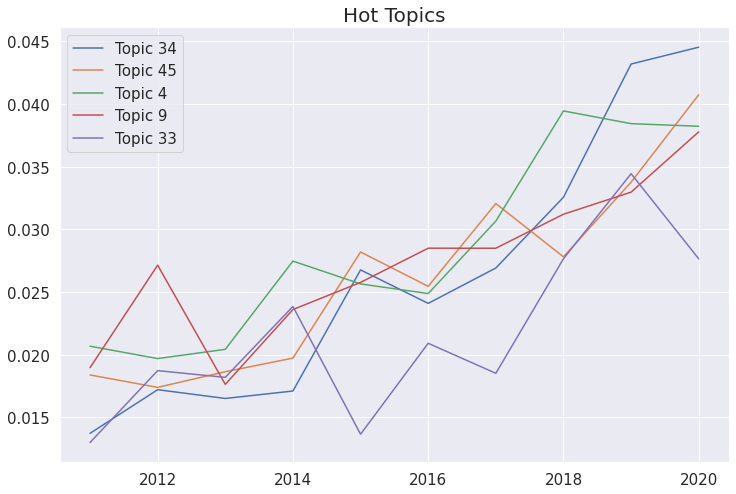

In [ ]:
plt.figure(figsize=(12,8))
for i in range(5):
  plt.plot(range(2011,2021), df_hot.drop("slope", axis=1).iloc[i], label=df_hot.drop("slope", axis=1).iloc[i].name)
  plt.legend()
  plt.title("Hot Topics")

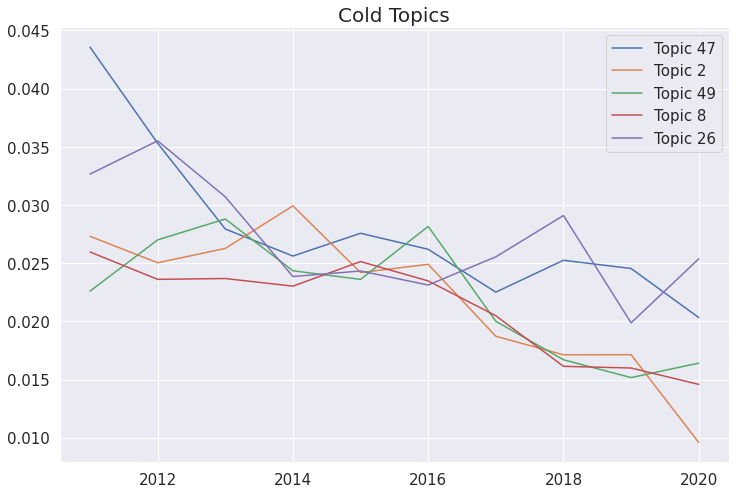

In [ ]:
plt.figure(figsize=(12,8))

for i in range(49,44,-1):
  plt.plot(range(2011,2021), df_hot.drop("slope", axis=1).iloc[i], label=df_hot.drop("slope", axis=1).iloc[i].name)
  plt.legend()
  plt.title("Cold Topics")

In [ ]:
df_jy = df_e.groupby(['Journal', 'Year']).mean()

Below table shows the topic distribuiton over years per journal. Even with this table the trends are not clear. 

In [ ]:
df_jy

Topic 1   Topic 2  ...  Topic 49  Topic 50
Journal                     Year                      ...                    
ANNALS OF TOURISM RESEARCH  2011  0.000183  0.032548  ...  0.007034  0.025390
                            2012  0.002754  0.002652  ...  0.011300  0.037835
                            2013  0.007558  0.005774  ...  0.009088  0.033452
                            2014  0.001875  0.014859  ...  0.005528  0.023819
                            2015  0.007995  0.038925  ...  0.011446  0.014173
...                                    ...       ...  ...       ...       ...
TOURISM RECREATION RESEARCH 2016  0.009969  0.046739  ...  0.016662  0.000133
                            2017  0.000715  0.013695  ...  0.004359  0.003940
                            2018  0.016744  0.009950  ...  0.007995  0.009967
                            2019  0.013494  0.013120  ...  0.018842  0.007895
                            2020  0.008114  0.012847  ...  0.024373  0.027806

[189 rows x 50 columns]

### Analysis wtih Mean  

In [ ]:
df_jy_melted = df_jy.reset_index().melt(id_vars=['Journal', 'Year'], value_vars=['Topic ' + str(i) for i in range(1,51)], var_name='Topic', value_name='Average')
df_jy_melted.sort_values(["Journal", "Year"]).head(60)

,Journal,Year,Topic,Average
0,ANNALS OF TOURISM RESEARCH,2011,Topic 1,0.000183
189,ANNALS OF TOURISM RESEARCH,2011,Topic 2,0.032548
378,ANNALS OF TOURISM RESEARCH,2011,Topic 3,0.302117
567,ANNALS OF TOURISM RESEARCH,2011,Topic 4,0.032736
756,ANNALS OF TOURISM RESEARCH,2011,Topic 5,0.034170
945,ANNALS OF TOURISM RESEARCH,2011,Topic 6,0.000111
1134,ANNALS OF TOURISM RESEARCH,2011,Topic 7,0.015273
1323,ANNALS OF TOURISM RESEARCH,2011,Topic 8,0.012408
1512,ANNALS OF TOURISM RESEARCH,2011,Topic 9,0.012565
1701,ANNALS OF TOURISM RESEARCH,2011,Topic 10,0.015441


In [ ]:
df_jy

Topic 1   Topic 2  ...  Topic 49  Topic 50
Journal                     Year                      ...                    
ANNALS OF TOURISM RESEARCH  2011  0.000183  0.032548  ...  0.007034  0.025390
                            2012  0.002754  0.002652  ...  0.011300  0.037835
                            2013  0.007558  0.005774  ...  0.009088  0.033452
                            2014  0.001875  0.014859  ...  0.005528  0.023819
                            2015  0.007995  0.038925  ...  0.011446  0.014173
...                                    ...       ...  ...       ...       ...
TOURISM RECREATION RESEARCH 2016  0.009969  0.046739  ...  0.016662  0.000133
                            2017  0.000715  0.013695  ...  0.004359  0.003940
                            2018  0.016744  0.009950  ...  0.007995  0.009967
                            2019  0.013494  0.013120  ...  0.018842  0.007895
                            2020  0.008114  0.012847  ...  0.024373  0.027806

[189 rows x 50 columns]

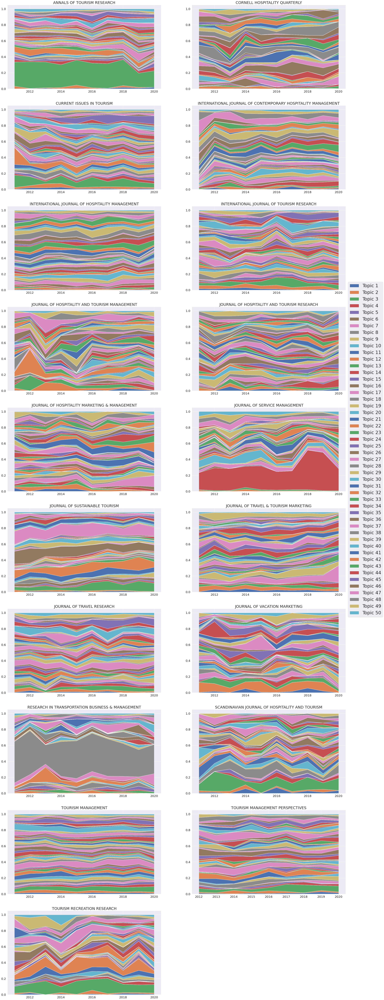

In [ ]:
params = {'axes.labelsize': 20,
          'axes.titlesize': 25,
          'xtick.labelsize': 20,
          'ytick.labelsize': 20,
          'legend.fontsize': 30}
          
plt.rcParams.update(params)

plt.figure(figsize=(40,120))

for i,j in enumerate(df_jy.index.levels[0]):
  
  plt.subplot(10, 2, i+1)
  plt.stackplot(df_jy.xs(j, level=0).index, df_jy.xs(j, level=0).reset_index().drop("Year", axis=1).T, labels=df_jy.columns)  
  plt.title(j)
  # plt.legend(loc='upper left')
  if i==9: plt.legend(loc='center left', bbox_to_anchor=(1.0,0.5))
  if i ==18: break




In [ ]:
# plt.figure(figsize=(30,60))

# for i, j in enumerate(df_jy_melted.Journal.unique()):
  
#   plt.subplot(7, 3, i+1)
 
#   Y= [df_jy_melted.query("Journal==@j & Topic ==@topic")["Average"].tolist() for topic in ['Topic ' + str(a) for a in range(1,51)]]

#   if j == "TOURISM MANAGEMENT PERSPECTIVES":
#     plt.stackplot(range(2012,2021), *Y)
#   else:
#     plt.stackplot(range(2011,2021), *Y)
#   plt.title(j)
#   if i ==19:
#     break


In [ ]:
df_jy

Topic 1   Topic 2  ...  Topic 49  Topic 50
Journal                     Year                      ...                    
ANNALS OF TOURISM RESEARCH  2011  0.000183  0.032548  ...  0.007034  0.025390
                            2012  0.002754  0.002652  ...  0.011300  0.037835
                            2013  0.007558  0.005774  ...  0.009088  0.033452
                            2014  0.001875  0.014859  ...  0.005528  0.023819
                            2015  0.007995  0.038925  ...  0.011446  0.014173
...                                    ...       ...  ...       ...       ...
TOURISM RECREATION RESEARCH 2016  0.009969  0.046739  ...  0.016662  0.000133
                            2017  0.000715  0.013695  ...  0.004359  0.003940
                            2018  0.016744  0.009950  ...  0.007995  0.009967
                            2019  0.013494  0.013120  ...  0.018842  0.007895
                            2020  0.008114  0.012847  ...  0.024373  0.027806

[189 rows x 50 columns]

In [ ]:
df_tem = pd.DataFrame()
df_tem["Av"] = df_jy.xs(j, level=0).mean(axis=0).values

In [ ]:
df_tem

,Av
0,0.008107
1,0.014568
2,0.123515
3,0.021532
4,0.007916
5,0.005450
6,0.002021
7,0.027061
8,0.009391
9,0.016604


In [ ]:
df_highest = pd.DataFrame()
for j in df_jy.index.levels[0]:
  
  df_temp = pd.DataFrame()
  df_temp["Topic"] = df_jy.xs(j, level=0).mean(axis=0).index
  df_temp["Average"] = df_jy.xs(j, level=0).mean(axis=0).values
  df_temp["Journal"]= j
  df_highest = pd.concat([df_highest, df_temp], axis=0)

In [ ]:
df_highest

,Topic,Average,Journal
0,Topic 1,0.007792,ANNALS OF TOURISM RESEARCH
1,Topic 2,0.013862,ANNALS OF TOURISM RESEARCH
2,Topic 3,0.287882,ANNALS OF TOURISM RESEARCH
3,Topic 4,0.026121,ANNALS OF TOURISM RESEARCH
4,Topic 5,0.019486,ANNALS OF TOURISM RESEARCH
...,...,...,...
45,Topic 46,0.007511,TOURISM RECREATION RESEARCH
46,Topic 47,0.044273,TOURISM RECREATION RESEARCH
47,Topic 48,0.023531,TOURISM RECREATION RESEARCH
48,Topic 49,0.045987,TOURISM RECREATION RESEARCH


In [ ]:
sns.set(font_scale=3.5)
sns.catplot(data=df_highest, x="Average", y= 'Topic', col="Journal", col_wrap=3, sharex=False, height=30, kind='bar');
# plt.savefig("doc.jpeg")

In [ ]:
# download("/content/doc.jpeg")

In [ ]:
df_highest

,Topic,Average,Journal
0,Topic 1,0.007792,ANNALS OF TOURISM RESEARCH
1,Topic 2,0.013862,ANNALS OF TOURISM RESEARCH
2,Topic 3,0.287882,ANNALS OF TOURISM RESEARCH
3,Topic 4,0.026121,ANNALS OF TOURISM RESEARCH
4,Topic 5,0.019486,ANNALS OF TOURISM RESEARCH
...,...,...,...
45,Topic 46,0.007511,TOURISM RECREATION RESEARCH
46,Topic 47,0.044273,TOURISM RECREATION RESEARCH
47,Topic 48,0.023531,TOURISM RECREATION RESEARCH
48,Topic 49,0.045987,TOURISM RECREATION RESEARCH


In [ ]:
df_highest["rank"] = df_highest.groupby("Journal")["Average"].rank(ascending=False)

In [ ]:
df_highest

,Topic,Average,Journal,rank
0,Topic 1,0.007792,ANNALS OF TOURISM RESEARCH,36.0
1,Topic 2,0.013862,ANNALS OF TOURISM RESEARCH,22.0
2,Topic 3,0.287882,ANNALS OF TOURISM RESEARCH,1.0
3,Topic 4,0.026121,ANNALS OF TOURISM RESEARCH,8.0
4,Topic 5,0.019486,ANNALS OF TOURISM RESEARCH,15.0
...,...,...,...,...
45,Topic 46,0.007511,TOURISM RECREATION RESEARCH,32.0
46,Topic 47,0.044273,TOURISM RECREATION RESEARCH,6.0
47,Topic 48,0.023531,TOURISM RECREATION RESEARCH,15.0
48,Topic 49,0.045987,TOURISM RECREATION RESEARCH,5.0


In [ ]:
df_highest.loc[df_highest["rank"]>3, "Average"] =0
df_highest

,Topic,Average,Journal,rank
0,Topic 1,0.000000,ANNALS OF TOURISM RESEARCH,36.0
1,Topic 2,0.000000,ANNALS OF TOURISM RESEARCH,22.0
2,Topic 3,0.287882,ANNALS OF TOURISM RESEARCH,1.0
3,Topic 4,0.000000,ANNALS OF TOURISM RESEARCH,8.0
4,Topic 5,0.000000,ANNALS OF TOURISM RESEARCH,15.0
...,...,...,...,...
45,Topic 46,0.000000,TOURISM RECREATION RESEARCH,32.0
46,Topic 47,0.000000,TOURISM RECREATION RESEARCH,6.0
47,Topic 48,0.000000,TOURISM RECREATION RESEARCH,15.0
48,Topic 49,0.000000,TOURISM RECREATION RESEARCH,5.0


In [ ]:
sns.set(font_scale=2.5)
sns.catplot(data=df_highest, x="Average", y= 'Topic', col="Journal", col_wrap=3, sharex=False, height=25, kind='bar');

In [ ]:
df_largest = pd.DataFrame()
for j in df_jy.index.levels[0]:
  
  df_temp = pd.DataFrame()
  df_temp["Topic"] = df_jy.xs(j, level=0).mean(axis=0).nlargest(3).index
  df_temp["Average"] = df_jy.xs(j, level=0).mean(axis=0).nlargest(3).values
  df_temp["Journal"]= j
  df_largest = pd.concat([df_largest, df_temp], axis=0)

In [ ]:
df_largest

,Topic,Average,Journal
0,Topic 3,0.287882,ANNALS OF TOURISM RESEARCH
1,Topic 12,0.054010,ANNALS OF TOURISM RESEARCH
2,Topic 37,0.036945,ANNALS OF TOURISM RESEARCH
0,Topic 16,0.076633,CORNELL HOSPITALITY QUARTERLY
1,Topic 28,0.072889,CORNELL HOSPITALITY QUARTERLY
2,Topic 38,0.069084,CORNELL HOSPITALITY QUARTERLY
0,Topic 3,0.086379,CURRENT ISSUES IN TOURISM
1,Topic 12,0.061429,CURRENT ISSUES IN TOURISM
2,Topic 45,0.055555,CURRENT ISSUES IN TOURISM
0,Topic 47,0.072056,INTERNATIONAL JOURNAL OF CONTEMPORARY HOSPITALITY MANAGEMENT


In [ ]:
large_labels = labels.copy()
large_labels.columns = ["Topic", "Labels"]
large_labels["Topic"] =large_labels["Topic"].astype("str")
large_labels["Topic"] = "Topic " + large_labels.Topic
large_labels 

,Topic,Labels
0,Topic 1,Event Tourism
1,Topic 2,Market Segmentation
2,Topic 3,Cultural Tourism
3,Topic 4,Value Creation
4,Topic 5,Urban Tourism
5,Topic 6,Sustainability
6,Topic 7,Brand Loyalty
7,Topic 8,Regional Entrepreneurship
8,Topic 9,Theory Of Planned Behavior
9,Topic 10,Business Strategy


In [ ]:
df_largest = pd.merge(df_largest, large_labels).sort_values(["Journal", "Average"], ascending=False)
df_largest = df_largest[["Topic", "Labels", "Average",	"Journal"]]
df_largest

,Topic,Labels,Average,Journal
6,Topic 3,Cultural Tourism,0.123515,TOURISM RECREATION RESEARCH
11,Topic 12,Sustainability Practices,0.103122,TOURISM RECREATION RESEARCH
16,Topic 37,Sustainability In Tourism Policy,0.074102,TOURISM RECREATION RESEARCH
15,Topic 37,Sustainability In Tourism Policy,0.055561,TOURISM MANAGEMENT PERSPECTIVES
5,Topic 3,Cultural Tourism,0.055185,TOURISM MANAGEMENT PERSPECTIVES
51,Topic 17,Forecasting Methods,0.049541,TOURISM MANAGEMENT PERSPECTIVES
50,Topic 17,Forecasting Methods,0.060632,TOURISM MANAGEMENT
4,Topic 3,Cultural Tourism,0.051456,TOURISM MANAGEMENT
34,Topic 40,Tourism Demand,0.051174,TOURISM MANAGEMENT
3,Topic 3,Cultural Tourism,0.129507,SCANDINAVIAN JOURNAL OF HOSPITALITY AND TOURISM


In [ ]:
# df_largest.to_excel("df_largest.xlsx", index=False)

In [ ]:
# download("/content/df_largest.xlsx")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
sns.set(font_scale=3)
sns.catplot(data=df_largest, x="Average", y= 'Topic', col="Journal", col_wrap=3, sharex=False, sharey=False, height=25, kind='bar');

<Figure size 2160x1440 with 0 Axes>

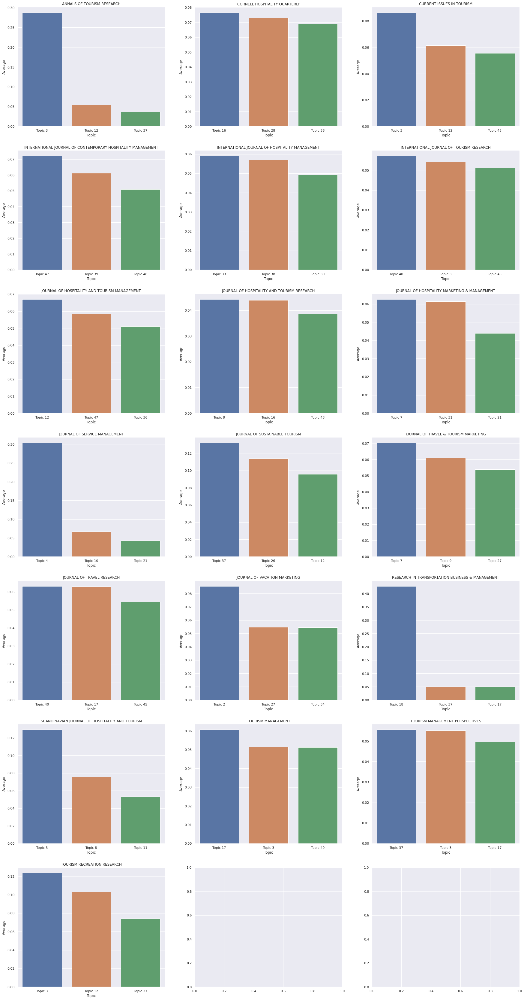

In [ ]:
sns.set(font_scale=1)

plt.rcParams['figure.figsize'] = [30, 60]

plt.figure(figsize=(30,20))
fig, ax =plt.subplots(7,3)
for ax,j in zip(ax.flat, df_largest["Journal"].unique()):
  
  df_temp= df_largest[df_largest["Journal"]==j]
  sns.barplot(data=df_temp, x='Topic', y="Average", ax=ax)
  ax.set_title(j)

In [ ]:
df_highest

,Topic,Average,Journal,rank
0,Topic 1,0.000000,ANNALS OF TOURISM RESEARCH,36.0
1,Topic 2,0.000000,ANNALS OF TOURISM RESEARCH,22.0
2,Topic 3,0.287882,ANNALS OF TOURISM RESEARCH,1.0
3,Topic 4,0.000000,ANNALS OF TOURISM RESEARCH,8.0
4,Topic 5,0.000000,ANNALS OF TOURISM RESEARCH,15.0
...,...,...,...,...
45,Topic 46,0.000000,TOURISM RECREATION RESEARCH,32.0
46,Topic 47,0.000000,TOURISM RECREATION RESEARCH,6.0
47,Topic 48,0.000000,TOURISM RECREATION RESEARCH,15.0
48,Topic 49,0.000000,TOURISM RECREATION RESEARCH,5.0


### Analysis with Max Prevelance

In [ ]:
df_e.drop(['Year', 'Journal'], axis=1, inplace=True)

In [ ]:
df_e['Max'] = df_e.idxmax(axis=1)

In [ ]:
df_e['Year']= df.Year; df_e['Journal']=df.Journal

Therefore we decided to find most dominant topic for each document rather than averaging the topic weights and then compute the percentage of documents in a given year where the topic is the most dominant. Below you can see on "Max" column the most dominant topic for each document. 

In [ ]:
df_e

,Topic 1,Topic 2,Topic 3,Topic 4,Topic 5,Topic 6,Topic 7,Topic 8,Topic 9,Topic 10,Topic 11,Topic 12,Topic 13,Topic 14,Topic 15,Topic 16,Topic 17,Topic 18,Topic 19,Topic 20,Topic 21,Topic 22,Topic 23,Topic 24,Topic 25,Topic 26,Topic 27,Topic 28,Topic 29,Topic 30,Topic 31,Topic 32,Topic 33,Topic 34,Topic 35,Topic 36,Topic 37,Topic 38,Topic 39,Topic 40,Topic 41,Topic 42,Topic 43,Topic 44,Topic 45,Topic 46,Topic 47,Topic 48,Topic 49,Topic 50,Max,Year,Journal
0,0.000015,0.000015,0.000015,0.172911,0.000015,0.000015,0.000015,0.378013,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.262749,0.000015,0.000015,0.000015,0.185624,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,0.000015,Topic 8,2020,JOURNAL OF SERVICE MANAGEMENT
1,0.000024,0.000024,0.000024,0.309463,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.268988,0.000024,0.000024,0.011774,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.003940,0.000024,0.000024,0.002635,0.402165,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,0.000024,Topic 39,2020,JOURNAL OF SERVICE MANAGEMENT
2,0.000019,0.000019,0.000019,0.000019,0.000019,0.000019,0.289271,0.000019,0.000019,0.000019,0.000019,0.000019,0.000019,0.000019,0.000019,0.000019,0.092879,0.004289,0.000019,0.000019,0.000019,0.000019,0.000019,0.000019,0.000019,0.000019,0.000019,0.000019,0.000019,0.000019,0.000019,0.000019,0.006423,0.323426,0.000019,0.101417,0.000019,0.152650,0.001087,0.000019,0.000019,0.000019,0.000019,0.000019,0.000019,0.000019,0.000019,0.000019,0.027770,0.000019,Topic 34,2020,JOURNAL OF SERVICE MANAGEMENT
3,0.000014,0.000014,0.161090,0.625552,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.212697,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,0.000014,Topic 4,2020,JOURNAL OF SERVICE MANAGEMENT
4,0.000023,0.000023,0.000023,0.419432,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.247797,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.001314,0.000023,0.000023,0.000023,0.000023,0.000023,0.000023,0.077453,0.000023,0.000023,0.000023,0.252959,Topic 4,2020,JOURNAL OF SERVICE MANAGEMENT
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11923,0.000044,0.170037,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.475531,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.012363,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.340030,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,0.000044,Topic 18,2011,RESEARCH IN TRANSPORTATION BUSINESS & MANAGEMENT
11924,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.153177,0.496981,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028,0.000028

Below is the dominant topics and their frequencies across the corpus.

In [ ]:
df_e.Max.value_counts()

Topic 3     787
Topic 12    441
Topic 37    412
Topic 17    389
Topic 4     372
Topic 9     368
Topic 34    360
Topic 40    342
Topic 45    338
Topic 7     337
Topic 26    336
Topic 47    322
Topic 10    314
Topic 33    281
Topic 31    277
Topic 18    276
Topic 49    275
Topic 27    261
Topic 48    255
Topic 24    255
Topic 2     249
Topic 39    246
Topic 38    242
Topic 8     233
Topic 11    228
Topic 28    207
Topic 29    203
Topic 36    198
Topic 21    190
Topic 16    190
Topic 32    189
Topic 44    187
Topic 42    180
Topic 15    154
Topic 20    150
Topic 14    146
Topic 19    144
Topic 43    140
Topic 25    140
Topic 13    140
Topic 50    140
Topic 35    135
Topic 41    132
Topic 23    131
Topic 46    123
Topic 6     111
Topic 30    107
Topic 1     106
Topic 5     105
Topic 22     84
Name: Max, dtype: int64

In [ ]:
df_count = df_e.groupby('Year')['Max'].value_counts().unstack()

In [ ]:
df_count['Total'] = df_count.sum(axis=1)


We computed the prevalence of the topics by identifying the topic with the highest weight per document, grouping the results by year, adding up the number of top occurrences of each topic per year and dividing by the total number of documents per year. as seen below the trends are more clear.

In [ ]:
df_count = df_e.groupby('Year')['Max'].value_counts(normalize=True).unstack()
df_count['Total'] = df_count.sum(axis=1)
df_count

Max,Topic 1,Topic 10,Topic 11,Topic 12,Topic 13,Topic 14,Topic 15,Topic 16,Topic 17,Topic 18,Topic 19,Topic 2,Topic 20,Topic 21,Topic 22,Topic 23,Topic 24,Topic 25,Topic 26,Topic 27,Topic 28,Topic 29,Topic 3,Topic 30,Topic 31,Topic 32,Topic 33,Topic 34,Topic 35,Topic 36,Topic 37,Topic 38,Topic 39,Topic 4,Topic 40,Topic 41,Topic 42,Topic 43,Topic 44,Topic 45,Topic 46,Topic 47,Topic 48,Topic 49,Topic 5,Topic 50,Topic 6,Topic 7,Topic 8,Topic 9,Total
Year,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2011,0.004603,0.028769,0.025316,0.046030,0.012658,0.016110,0.008055,0.011507,0.034522,0.031070,0.013809,0.019563,0.016110,0.012658,0.005754,0.013809,0.016110,0.020713,0.036824,0.024166,0.023015,0.021864,0.062140,0.005754,0.026467,0.016110,0.010357,0.016110,0.011507,0.025316,0.027618,0.023015,0.021864,0.019563,0.023015,0.014960,0.011507,0.005754,0.018412,0.020713,0.019563,0.046030,0.021864,0.024166,0.006904,0.006904,0.004603,0.017261,0.027618,0.021864,1.0
2012,0.013052,0.023092,0.027108,0.035141,0.008032,0.010040,0.011044,0.014056,0.038153,0.031124,0.013052,0.024096,0.008032,0.016064,0.010040,0.013052,0.021084,0.014056,0.036145,0.016064,0.020080,0.025100,0.078313,0.016064,0.025100,0.010040,0.021084,0.018072,0.009036,0.021084,0.037149,0.024096,0.014056,0.020080,0.032129,0.011044,0.010040,0.006024,0.008032,0.015060,0.014056,0.035141,0.019076,0.030120,0.009036,0.015060,0.008032,0.014056,0.021084,0.030120,1.0
2013,0.005076,0.022335,0.025381,0.036548,0.011168,0.010152,0.011168,0.007107,0.029442,0.014213,0.017259,0.030457,0.022335,0.018274,0.004061,0.007107,0.024365,0.007107,0.041624,0.025381,0.015228,0.022335,0.068020,0.006091,0.020305,0.017259,0.019289,0.022335,0.010152,0.023350,0.034518,0.021320,0.019289,0.022335,0.027411,0.014213,0.019289,0.015228,0.017259,0.019289,0.019289,0.029442,0.019289,0.032487,0.007107,0.013198,0.008122,0.023350,0.027411,0.015228,1.0
2014,0.013065,0.029146,0.019095,0.040201,0.010050,0.012060,0.006030,0.015075,0.028141,0.016080,0.013065,0.033166,0.010050,0.019095,0.012060,0.010050,0.024121,0.009045,0.023116,0.021106,0.018090,0.014070,0.055276,0.008040,0.024121,0.018090,0.025126,0.018090,0.014070,0.015075,0.050251,0.015075,0.020101,0.029146,0.032161,0.014070,0.018090,0.010050,0.015075,0.019095,0.014070,0.026131,0.020101,0.026131,0.008040,0.018090,0.017085,0.025126,0.024121,0.024121,1.0
2015,0.007162,0.034020,0.011638,0.041182,0.008057,0.008953,0.018800,0.013429,0.034915,0.031334,0.009848,0.022381,0.008953,0.017010,0.002686,0.008953,0.021486,0.013429,0.026858,0.024172,0.024172,0.026858,0.052820,0.011638,0.036705,0.009848,0.012534,0.027753,0.015219,0.015219,0.040286,0.026858,0.009848,0.025962,0.026858,0.017905,0.013429,0.009848,0.019696,0.022381,0.008057,0.025962,0.024172,0.025067,0.007162,0.008953,0.008057,0.030439,0.021486,0.029543,1.0
2016,0.012126,0.025061,0.018593,0.036378,0.009701,0.009701,0.012126,0.018593,0.026677,0.023444,0.012935,0.026677,0.013743,0.018593,0.004042,0.008892,0.025061,0.016977,0.020210,0.022635,0.016168,0.020210,0.070331,0.008084,0.021827,0.016977,0.020210,0.028294,0.009701,0.013743,0.038804,0.012126,0.029103,0.024252,0.029911,0.013743,0.017785,0.013743,0.016977,0.025061,0.005659,0.027486,0.020210,0.033145,0.009701,0.012935,0.008892,0.025869,0.020210,0.026677,1.0
2017,0.008689,0.022448,0.021723,0.028240,0.015206,0.013758,0.013034,0.020999,0.036206,0.034033,0.012310,0.018103,0.013034,0.014482,0.013758,0.016655,0.017379,0.007241,0.030413,0.021723,0.018827,0.013758,0.078204,0.012310,0.022448,0.014482,0.018103,0.030413,0.009413,0.013758,0.028965,0.018103,0.020275,0.034033,0.033309,0.007241,0.013758,0.015206,0.013758,0.034033,0.004345,0.020275,0.016655,0.022448,0.010138,0.007241,0.010138,0.026068,0.018827,0.034033,1.0
2018,0.011228,0.029474,0.018947,0.033684,0.009825,0.015439,0.009825,0.013333,0.037193,0.028772,0.011228,0.018246,0.011228,0.013333,0.009825,0.008421,0.021754,0.011930,0.029474,0.025263,0.011930,0.011930,0.072982,0.006316,0.017544,0.014737,0.030877,0.030877,0.015439,0.011228,0.030

Below table shows the average prevelance of topics for each journal in a given year.

In [ ]:
df_count_j = df_e.groupby(['Journal', 'Year'])['Max'].value_counts(normalize=True).unstack()
df_count_j['Total'] = df_count_j.sum(axis=1)
df_j = df_count_j.reset_index()

# delete the columns name
df_j.columns.name=None

df_j.set_index(['Journal', 'Year'])

Topic 1  Topic 10  ...   Topic 9  Total
Journal                     Year                      ...                 
ANNALS OF TOURISM RESEARCH  2011       NaN  0.015152  ...       NaN    1.0
                            2012       NaN  0.011494  ...       NaN    1.0
                            2013       NaN       NaN  ...  0.013514    1.0
                            2014       NaN  0.027027  ...  0.027027    1.0
                            2015       NaN  0.036364  ...       NaN    1.0
...                                    ...       ...  ...       ...    ...
TOURISM RECREATION RESEARCH 2016  0.034483  0.068966  ...       NaN    1.0
                            2017       NaN       NaN  ...  0.023256    1.0
                            2018       NaN       NaN  ...       NaN    1.0
                            2019       NaN       NaN  ...  0.057692    1.0
                            2020       NaN       NaN  ...  0.035714    1.0

[189 rows x 51 columns]

In [ ]:
df_j

,Journal,Year,Topic 1,Topic 10,Topic 11,Topic 12,Topic 13,Topic 14,Topic 15,Topic 16,Topic 17,Topic 18,Topic 19,Topic 2,Topic 20,Topic 21,Topic 22,Topic 23,Topic 24,Topic 25,Topic 26,Topic 27,Topic 28,Topic 29,Topic 3,Topic 30,Topic 31,Topic 32,Topic 33,Topic 34,Topic 35,Topic 36,Topic 37,Topic 38,Topic 39,Topic 4,Topic 40,Topic 41,Topic 42,Topic 43,Topic 44,Topic 45,Topic 46,Topic 47,Topic 48,Topic 49,Topic 5,Topic 50,Topic 6,Topic 7,Topic 8,Topic 9,Total
0,ANNALS OF TOURISM RESEARCH,2011,NaN,0.015152,NaN,0.075758,0.015152,NaN,NaN,NaN,0.015152,NaN,NaN,0.015152,NaN,NaN,0.030303,NaN,NaN,0.015152,0.045455,NaN,NaN,0.075758,0.333333,NaN,0.015152,NaN,NaN,0.030303,0.015152,0.030303,0.030303,NaN,NaN,0.030303,NaN,NaN,NaN,NaN,0.045455,0.045455,0.015152,NaN,0.015152,NaN,0.030303,0.030303,NaN,0.015152,0.015152,NaN,1.0
1,ANNALS OF TOURISM RESEARCH,2012,NaN,0.011494,0.022989,0.080460,0.034483,NaN,NaN,NaN,0.011494,NaN,0.022989,NaN,NaN,0.022989,0.011494,NaN,0.034483,0.011494,0.045977,0.011494,NaN,0.011494,0.390805,NaN,NaN,0.011494,NaN,NaN,0.011494,NaN,0.057471,NaN,0.011494,NaN,0.011494,NaN,NaN,NaN,NaN,0.022989,0.011494,0.011494,0.034483,0.011494,NaN,0.057471,NaN,NaN,0.022989,NaN,1.0
2,ANNALS OF TOURISM RESEARCH,2013,NaN,NaN,0.013514,0.054054,0.013514,NaN,0.027027,NaN,NaN,NaN,0.054054,NaN,0.040541,NaN,NaN,NaN,0.027027,NaN,0.027027,0.013514,NaN,NaN,0.391892,0.013514,NaN,0.013514,0.013514,NaN,NaN,NaN,0.081081,NaN,NaN,0.013514,0.054054,NaN,NaN,NaN,0.027027,0.013514,0.013514,NaN,0.027027,NaN,NaN,0.027027,NaN,NaN,0.027027,0.013514,1.0
3,ANNALS OF TOURISM RESEARCH,2014,NaN,0.027027,NaN,0.081081,0.027027,NaN,NaN,0.013514,0.013514,NaN,0.013514,0.027027,0.013514,NaN,0.013514,NaN,0.013514,NaN,0.013514,0.013514,NaN,0.027027,0.364865,0.013514,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.054054,0.067568,0.013514,NaN,NaN,0.040541,0.027027,NaN,NaN,NaN,NaN,0.013514,0.040541,0.013514,NaN,0.027027,0.027027,1.0
4,ANNALS OF TOURISM RESEARCH,2015,NaN,0.036364,NaN,0.072727,0.036364,NaN,NaN,NaN,0.018182,NaN,0.018182,0.036364,0.018182,NaN,NaN,NaN,0.018182,0.018182,0.054545,NaN,NaN,0.018182,0.381818,0.018182,NaN,NaN,NaN,0.036364,NaN,0.018182,0.036364,NaN,NaN,NaN,0.018182,NaN,NaN,NaN,0.054545,0.036364,NaN,NaN,NaN,0.018182,NaN,0.018182,NaN,NaN,0.018182,NaN,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
184,TOURISM RECREATION RESEARCH,2016,0.034483,0.068966,0.034483,0.172414,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.034483,NaN,NaN,0.034483,NaN,0.068966,0.103448,0.034483,NaN,NaN,0.034483,0.137931,NaN,NaN,NaN,NaN,NaN,0.034483,NaN,0.068966,NaN,NaN,NaN,NaN,NaN,NaN,0.034483,NaN,NaN,NaN,0.068966,NaN,0.034483,NaN,NaN,NaN,NaN,NaN,NaN,1.0
185,TOURISM RECREATION RESEARCH,2017,NaN,NaN,0.069767,0.139535,NaN,NaN,0.023256,NaN,NaN,0.023256,NaN,NaN,NaN,NaN,0.116279,NaN,0.023256,NaN,0.023256,NaN,NaN,0.046512,0.255814,0.046512,NaN,NaN,NaN,NaN,NaN,NaN,0.046512,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.023256,NaN,NaN,0.023256,0.069767,NaN,NaN,NaN,NaN,NaN,0.046512,0.023256,1.0
186,TOURISM RECREATION RESEARCH,2018,NaN,NaN,0.023810,0.071429,NaN,NaN,0.023810,NaN,NaN,0.023810,0.047619,NaN,0.023810,NaN,0.047619,NaN,0.071429,NaN,0.095238,NaN,NaN,0.047619,0.119048,0.023810,NaN,NaN,NaN,0.047619,NaN,NaN,0.095238,NaN,NaN,NaN,NaN,0.023810,NaN,0.047619,0.047619,NaN,NaN,0.071429,0.023810,NaN,NaN,NaN,NaN,NaN,0.023810,NaN,1.0
187,TOURISM RECREATION RESEARCH,2019,NaN,NaN,0.057692,0.173077,NaN,0.019231,0.057692,NaN,NaN,NaN,NaN,NaN,0.019231,NaN,0.019231,NaN,0.096154,0.038462,0.019231,0.019231,NaN,NaN,0.115385,0.019231,0.019231,0.038462,NaN,0.019231,NaN,0.019231,0.019231,NaN,NaN,0.038462,0.019231,NaN,NaN,NaN,NaN,0.019231,NaN,0.038462,0.038462,NaN,NaN,NaN,NaN,NaN,0.019231,0.057692,1.0


In [ ]:
df_j_melted = df_j.melt(id_vars=['Journal', 'Year'], value_vars=['Topic ' + str(i) for i in range(1,51)], var_name='Topic', value_name='Prevelance')


In [ ]:
df_j_melted.sort_values(["Journal", "Year"])

,Journal,Year,Topic,Prevelance
0,ANNALS OF TOURISM RESEARCH,2011,Topic 1,NaN
189,ANNALS OF TOURISM RESEARCH,2011,Topic 2,0.015152
378,ANNALS OF TOURISM RESEARCH,2011,Topic 3,0.333333
567,ANNALS OF TOURISM RESEARCH,2011,Topic 4,0.030303
756,ANNALS OF TOURISM RESEARCH,2011,Topic 5,0.030303
...,...,...,...,...
8693,TOURISM RECREATION RESEARCH,2020,Topic 46,NaN
8882,TOURISM RECREATION RESEARCH,2020,Topic 47,0.035714
9071,TOURISM RECREATION RESEARCH,2020,Topic 48,NaN
9260,TOURISM RECREATION RESEARCH,2020,Topic 49,0.035714


Below you can find subgraphs for topic distribuition over time for each journal.

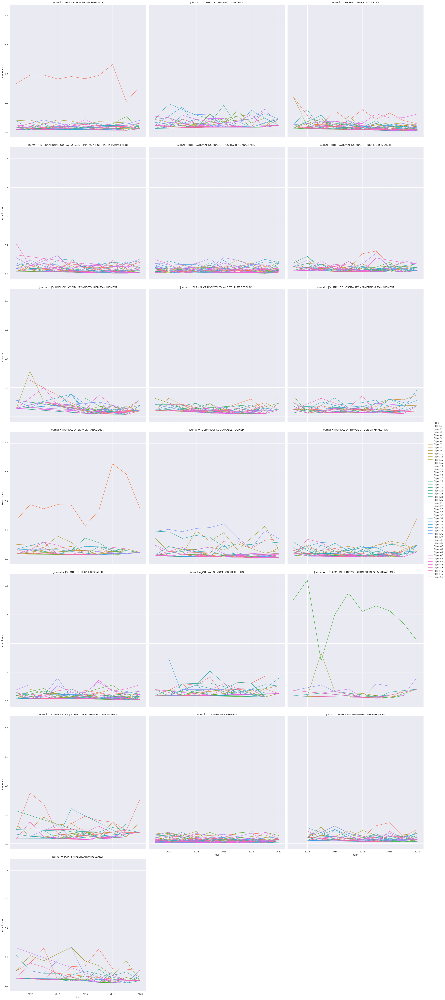

In [ ]:
sns.relplot(x='Year', y="Prevelance", col="Journal", col_wrap=3, hue='Topic',
            data=df_j_melted,
            kind="line",
            height=10,
            style="Topic",
            # markers=True)
            dashes=False,
            ci=None)

In [ ]:
df_count_j.drop('Total', axis=1, inplace=True)

In [ ]:
df_count_j

Max                                Topic 1  Topic 10  ...   Topic 8   Topic 9
Journal                     Year                      ...                    
ANNALS OF TOURISM RESEARCH  2011       NaN  0.015152  ...  0.015152       NaN
                            2012       NaN  0.011494  ...  0.022989       NaN
                            2013       NaN       NaN  ...  0.027027  0.013514
                            2014       NaN  0.027027  ...  0.027027  0.027027
                            2015       NaN  0.036364  ...  0.018182       NaN
...                                    ...       ...  ...       ...       ...
TOURISM RECREATION RESEARCH 2016  0.034483  0.068966  ...       NaN       NaN
                            2017       NaN       NaN  ...  0.046512  0.023256
                            2018       NaN       NaN  ...  0.023810       NaN
                            2019       NaN       NaN  ...  0.019231  0.057692
                            2020       NaN       NaN  ...       NaN  0.035714

[189 rows x 50 columns]

In [ ]:
plt.rcParams['figure.figsize'] = [12, 8]

Below is the stacked version of the above graphs.

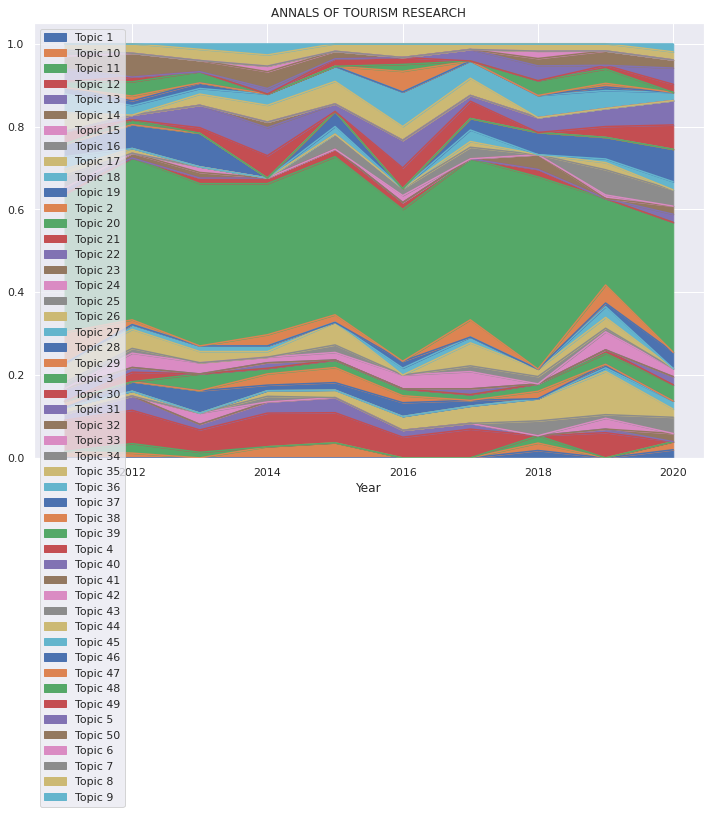

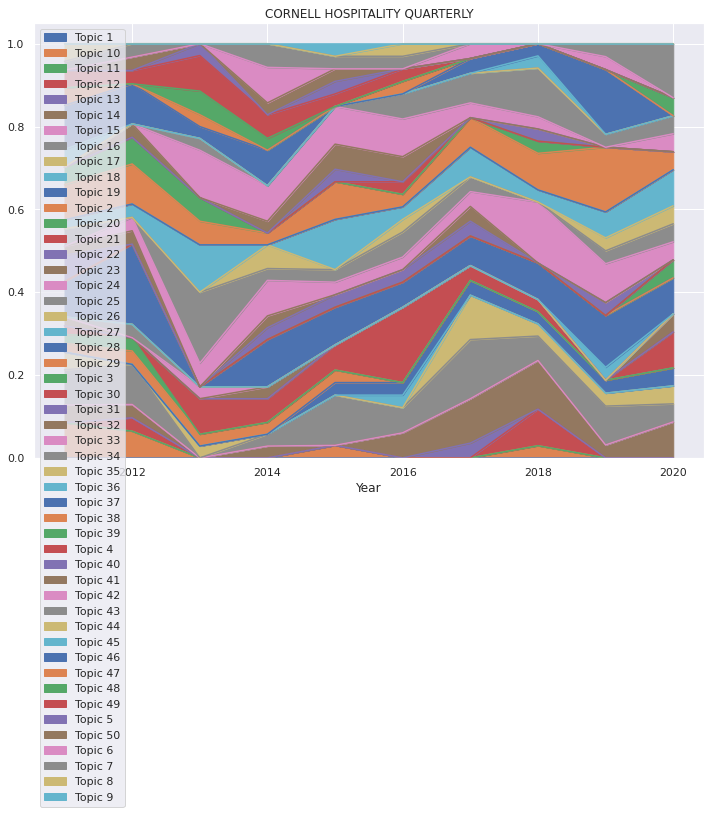

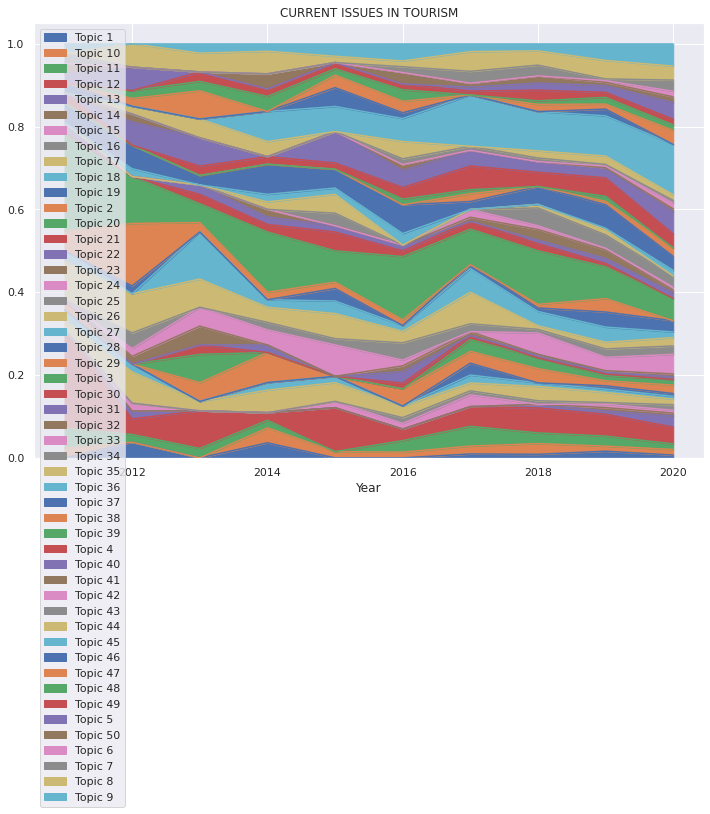

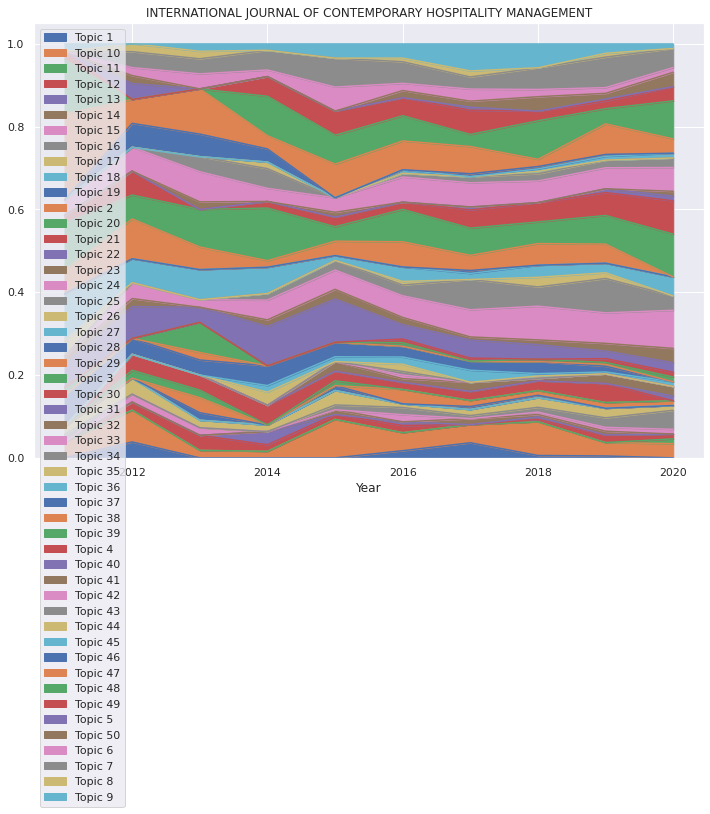

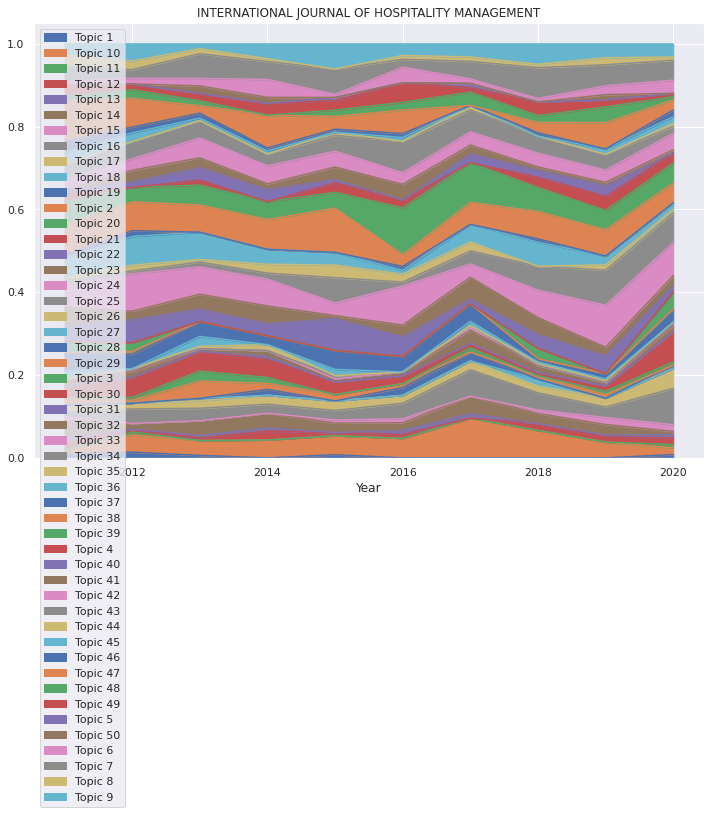

...

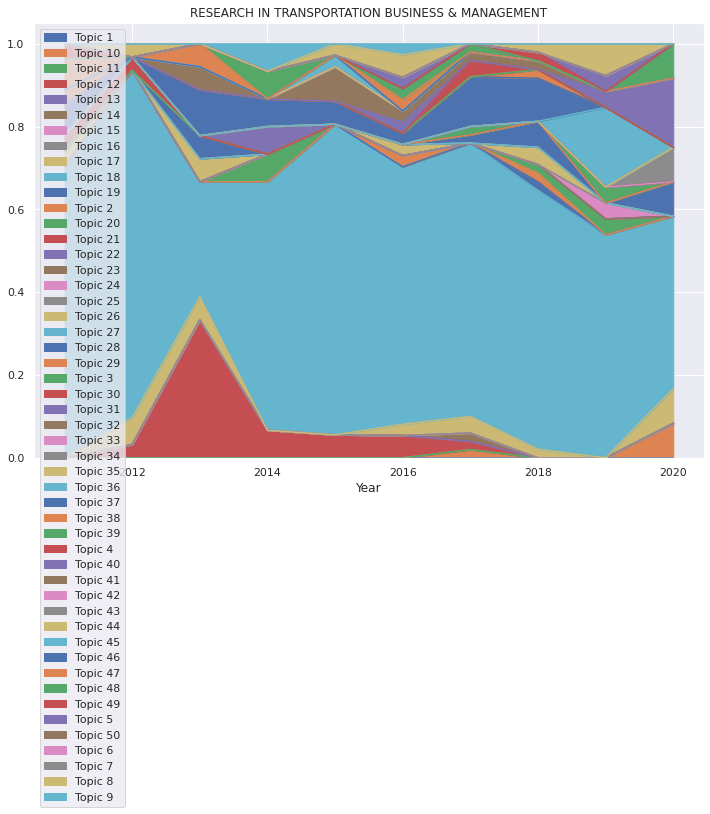

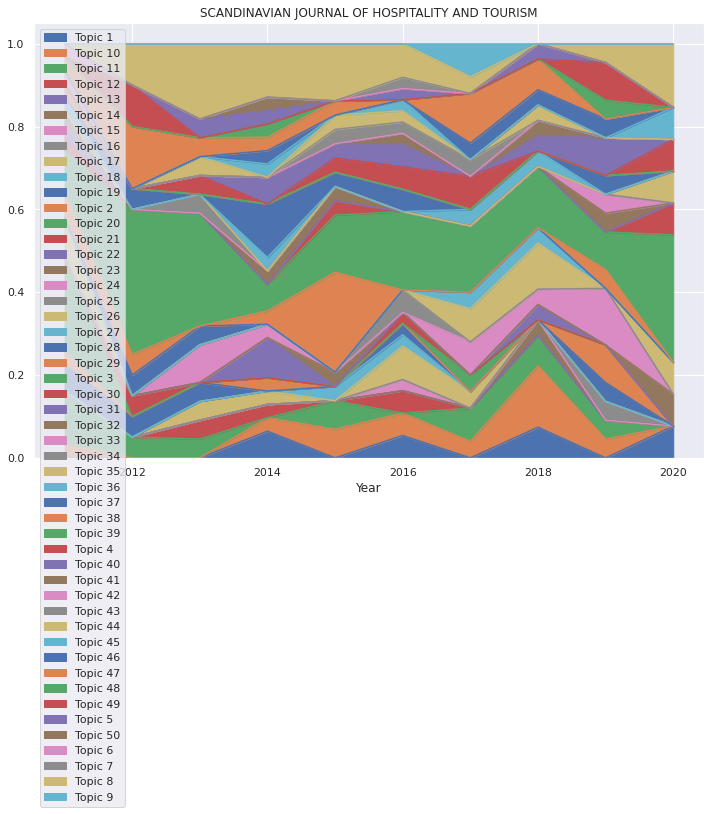

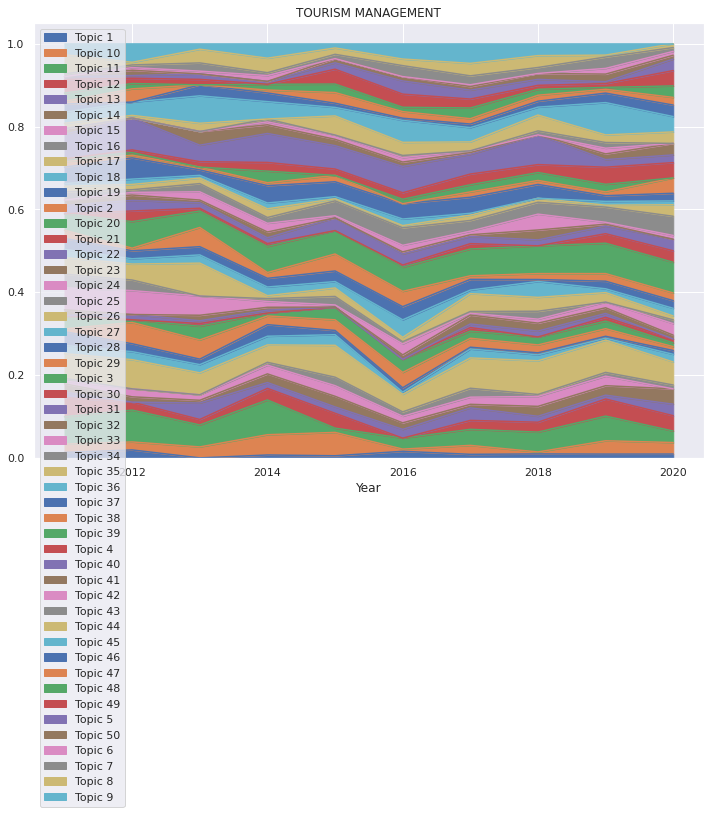

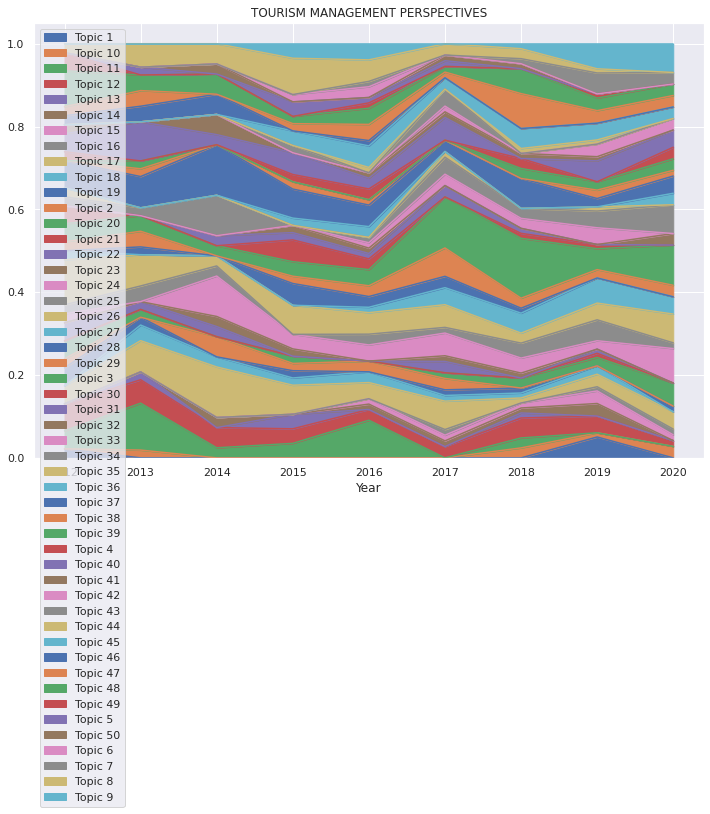

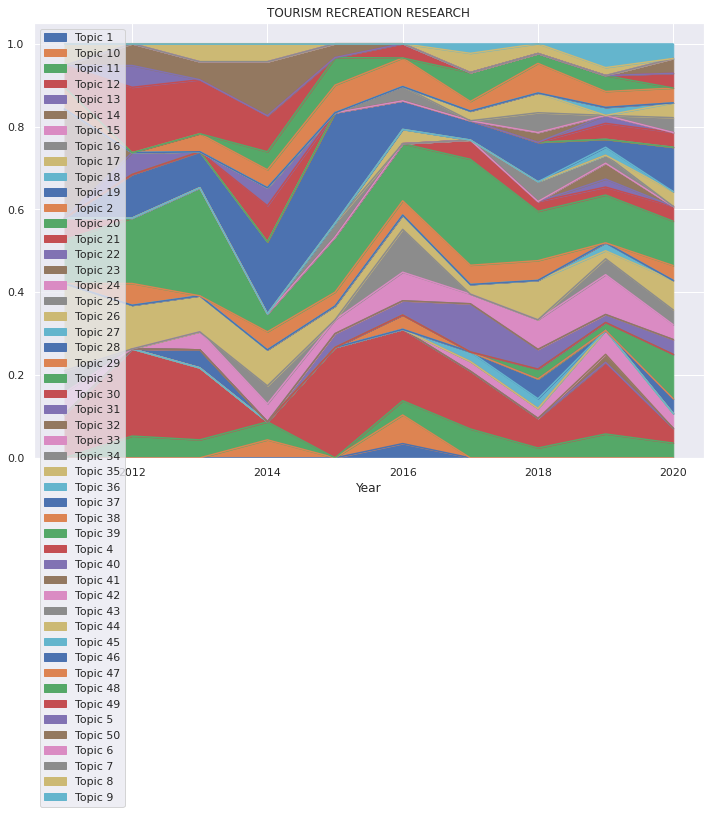

In [ ]:
for j in df_count_j.index.levels[0]:
  df_count_j.xs(j, level=0).plot.area()
  plt.title(j)
  plt.legend(loc='upper left')
  plt.show()


### LDA Tuning: Finding the Optimal Number of Topics

In [ ]:
# from tqdm import tqdm

# def topic_model_coherence_generator(corpus, texts, dictionary, start_topic_count=2, end_topic_count=10, step=1, cpus=1):
#   models = []
#   coherence_scores = []
#   for topic_nums in tqdm(range(start_topic_count, end_topic_count+1, step)):
#     mallet_lda_model = gensim.models.wrappers.LdaMallet(mallet_path=mallet_path, corpus=corpus, num_topics=topic_nums,
#                                                             id2word=dictionary, iterations=2000, workers=cpus, alpha=0.2)
      
#     cv_coherence_model_mallet_lda = gensim. models.CoherenceModel (model=mallet_lda_model, corpus=corpus, texts=texts,
#                                                                      dictionary=dictionary, coherence='c_v')
      
#     coherence_score = cv_coherence_model_mallet_lda.get_coherence()
#     coherence_scores.append(coherence_score)
#     models.append(mallet_lda_model)
#   return models, coherence_scores

* We build several topic models, with the number of topics ranging from 2 to 50.

In [ ]:
# lda_models, coherence_scores = topic_model_coherence_generator(corpus=corpus, texts=data_ready, dictionary=id2word,
#                                                                start_topic_count=2, end_topic_count=50, step=2, cpus=64)

In [ ]:
# x_ax = range(2, 51, 2)
# y_ax = coherence_scores

# plt.figure(figsize=(12, 6))
# plt.plot(x_ax, y_ax, c='r')

# plt.axhline(y=0.45, c='k', linestyle='--', linewidth=2)
# plt.rcParams['figure.facecolor'] = 'white'

# xl = plt.xlabel('Number of Topics')
# yl = plt.ylabel('Coherence Score')

# plt.show()

In [ ]:
# coherence_df = pd.DataFrame({'Number of Topics': range(2, 51, 1), 'Coherence Score': np.round(coherence_scores, 4)})

#coherence_df.sort_values(by=['Coherence Score'], ascending=False).head(10)

In [ ]:
# x_ax = range(2, 51, 1)
# y_ax = coherence_scores

# plt.figure(figsize=(12, 6))
# plt.plot(x_ax, y_ax, c='r')

# plt.axhline(y=0.43, c='k', linestyle='--', linewidth=2)
# plt.rcParams['figure.facecolor'] = 'white'

# xl = plt.xlabel('Number of Topics')
# yl = plt.ylabel('Coherence Score')

# plt.show()

* it looks like the score starts increasing rapidly until 10 topics and gradually starts plateauing.